# Imports

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
import os
os.chdir("/content/drive/MyDrive/mlproject")
!ls

 all_authors.tsv
 all_publications.tsv
 dbscan_28_5_all_mini_l6v2.pickle
 dbscan_28_5_all_minilm_l3v2.pickle
 dbscan_30_5_all_mini_l6v2.pickle
 dbscan_30_5_all_minilm_l3v2.pickle
 dbscan_32_5_all_mini_l6v2.pickle
 dbscan_32_5_all_minilm_l3v2.pickle
 dbscan_35_5_all_mini_l6v2.pickle
 dbscan_37_5_all_mpnet_basev2.pickle
 dbscan_38_5_all_mpnet_basev2.pickle
 dbscan_40_5_all_mpnet_basev2.pickle
 dbscan_42_5_all_mpnet_basev2.pickle
 DBSCAN_and_GM.ipynb
'DBSCAN-GM embedding+categorical.ipynb'
 dbscan_manhattan_270_5_all_minilm_l3v2.pickle
 dbscan_manhattan_280_5_all_mini_l6v2.pickle
 dbscan_manhattan_420_5_all_mpnet_basev2.pickle
 gm_100_all_mini_l6v2_.pickle
 gm_150_all_mini_l6v2_.pickle
 gm_150_all_minilm_l3v2_.pickle
 gm_150_all_minilm_l3v2_random_from_data.pickle
 gm_150_all_mpnet_basev2.pickle
 gm_150_spherical_all_mini_l6v2_kmeans++.pickle
 gm_150_spherical_all_mini_l6v2_.pickle
 gm_150_spherical_all_mini_l6v2_random_from_data.pickle
 gm_150_spherical_all_mini_l6v2_random.pickle
 gm_15

In [ ]:
!pip install -U scikit-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 9.7 MB 8.3 MB/s 
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.0.2
    Uninstalling scikit-learn-1.0.2:
      Successfully uninstalled scikit-learn-1.0.2


In [ ]:
!pip install sentence_transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 85 kB 5.7 MB/s 
     |████████████████████████████████| 5.8 MB 50.6 MB/s 
     |████████████████████████████████| 1.3 MB 48.6 MB/s 
     |████████████████████████████████| 182 kB 70.8 MB/s 
     |████████████████████████████████| 7.6 MB 58.7 MB/s 
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125938 sha256=9951359034155b319bc755b22fd8d89d33312a4a4b5df0e49586c556503f4ff2
  Stored in directory: /root/.cache/pip/wheels/5e/6f/8c/d88aec621f3f542d26fac0342bef5e693335d125f4e54aeffe
Successfully built sentence-transformers


In [3]:
#NLP 
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
from spacy.lang.en import English

import string

from multiprocessing import  Pool
import numpy as np
import pandas as pd

#from sentence_transformers import SentenceTransformer
#from sentence_transformers import util
import tensorflow as tf
from sklearn.preprocessing import StandardScaler

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.mixture import GaussianMixture
import pickle


In [122]:
#read data from .tsv files
import pandas as pd
df_all_authors = pd.read_csv("all_authors.tsv", sep='\t', encoding= 'ISO-8859-1')
df_all_publications = pd.read_csv("all_publications.tsv", sep='\t')
df_selected_author_publications = pd.read_csv("selected_author_publications_information.tsv", sep='\t')
df_selected_publication_citations = pd.read_csv("selected_publication_citations_information.tsv", sep='\t')

In [123]:
# Drop duplicates
df_all_publications.drop_duplicates(inplace=True)
df_selected_publication_citations.drop_duplicates(inplace=True)

# Drop NA's
#
print(df_all_publications.isna().sum())
print(df_selected_publication_citations.isna().sum())
df_selected_publication_citations.drop(['citation_sentence_cited'], axis=1, inplace=True)
df_all_publications.dropna(inplace=True)
print(df_all_publications.isna().sum())

paper_id                         0
paper_dblp_key                   0
paper_title                      0
paper_filtered_title             0
paper_published_date             0
paper_published_conference       0
paper_gscholar_url               0
paper_dblp_url                   0
paper_abstract                2529
dtype: int64
citing_paper_id                   0
cited_paper_id                    0
citation_title                    0
citation_filtered_title           0
citation_sentence_before       3843
citation_sentence_cited          25
citation_sentence_after        3391
citation_position (section)       0
dtype: int64
paper_id                      0
paper_dblp_key                0
paper_title                   0
paper_filtered_title          0
paper_published_date          0
paper_published_conference    0
paper_gscholar_url            0
paper_dblp_url                0
paper_abstract                0
dtype: int64


In [124]:
titles    = []
abstracts = []
confs      = []
citeds    = []
cited_confs = []
cited_abs = []

for cited_idx, title in enumerate(df_selected_publication_citations['citation_filtered_title']):
    paper_id_found = False
    cited_paper_id = df_selected_publication_citations['cited_paper_id'].iloc[cited_idx]   
    paper_id = df_selected_publication_citations["citing_paper_id"].iloc[cited_idx]

    # All publications has not contain paper information for paper_id = 5835
    try:
        citeds.append(title)
        titles.append(df_all_publications['paper_title'].iloc[df_all_publications.index[df_all_publications['paper_id'] == paper_id].tolist()[0]])
        abstracts.append(df_all_publications['paper_abstract'].iloc[df_all_publications.index[df_all_publications['paper_id'] == paper_id].tolist()[0]])
        confs.append(df_all_publications['paper_published_conference'].iloc[df_all_publications.index[df_all_publications['paper_id'] == paper_id].tolist()[0]])
        paper_id_found = True
        cited_confs.append(df_all_publications['paper_published_conference'].iloc[df_all_publications.index[df_all_publications['paper_id'] == cited_paper_id].tolist()[0]])
        cited_abs.append(df_all_publications['paper_abstract'].iloc[df_all_publications.index[df_all_publications['paper_id'] == cited_paper_id].tolist()[0]])
    except:
        if paper_id_found:
            titles.pop()
            abstracts.pop()
            confs.pop()
            citeds.pop()
        continue

In [125]:
headers = ['paper_title', 'paper_abstract', 'paper_published_conference', 'cited_paper_title', 'cited_paper_published_conference', 'cited_paper_abstract']
df = pd.DataFrame(list(zip(titles, abstracts, confs, citeds, cited_confs, cited_abs)),
               columns = headers)

df['paper_abstract'] = df['paper_abstract'].astype(str).map(lambda x: x.lstrip('[').rstrip(']'))
df['cited_paper_abstract'] = df['cited_paper_abstract'].astype(str).map(lambda x: x.lstrip('[').rstrip(']'))
df = df.drop_duplicates()


In [126]:
punctuations = string.punctuation
stopwords = list(STOP_WORDS)
stopwords[:10]

custom_stop_words = [
    'doi', 'preprint', 'copyright', 'peer', 'reviewed', 'org', 'https', 'et', 'al', 'author', 'figure', 
    'rights', 'reserved', 'permission', 'used', 'using', 'biorxiv', 'medrxiv', 'license', 'fig', 'fig.', 
    'al.', 'Elsevier', 'PMC', 'CZI', 'www'
]

for w in custom_stop_words:
    if w not in stopwords:
        stopwords.append(w)

print(len(stopwords))

350


In [127]:
parser = spacy.load("en_core_web_sm")
parser.max_length = 7000000

def call_tokenizer(df):
    df["text"] = df["text"].apply(spacy_tokenizer)
    #df["paper_title"] = df["paper_title"].apply(spacy_tokenizer)
    #df["processed_cited_paper_abstract"] = df["cited_paper_abstract"].apply(spacy_tokenizer)
    return df

def spacy_tokenizer(sentence):
    mytokens = parser(sentence)
    mytokens = [ word.lemma_.lower().strip() if word.lemma_ != "-PRON-" else word.lower_ for word in mytokens ]
    mytokens = [ word for word in mytokens if word not in stopwords and word not in punctuations ]
    mytokens = " ".join([i for i in mytokens])
    return mytokens

In [128]:
def parallelize_dataframe(df, func, n_cores=4):
    df_split = np.array_split(df, n_cores)
    pool = Pool(n_cores)
    df = pd.concat(pool.map(func, df_split))
    pool.close()
    pool.join()
    return df

In [175]:
df["text"] = df["paper_title"] + df["paper_abstract"] + df["cited_paper_title"] + df["cited_paper_abstract"] 

In [176]:
list_paper_published_conference = df['paper_published_conference']
dict_paper_published_conference = dict([(y,x+1) for x,y in enumerate(sorted(set(list_paper_published_conference)))])

In [177]:
list_cited_paper_published_conference = df['cited_paper_published_conference']
dict_cited_paper_published_conference = dict([(y,x+1) for x,y in enumerate(sorted(set(list_cited_paper_published_conference)))])

In [178]:
df.reset_index(drop=True, inplace=True)
df.head()

,paper_title,paper_abstract,paper_published_conference,cited_paper_title,cited_paper_published_conference,cited_paper_abstract,text,label
0,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,the effects of transparency on trust in and ac...,Internet Measurement Conference,"Traditionally, users have discovered informati...",Linked open data-based explanations for transp...,27
1,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,explaining collaborative filtering recommendat...,Interactive Decision Theory and Game Theory,"We develop a Bayesian approach, to concept lea...",Linked open data-based explanations for transp...,47
2,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,tagsplanations explaining recommendations usin...,ACM Trans. Economics and Comput.,The final step in getting an Israeli M.D. is p...,Linked open data-based explanations for transp...,70
3,Moving from Item Rating to Features Relevance ...,Although very effective in computing accurate ...,IIR,sparse linear methods with side information fo...,IEEE Trans. Pattern Anal. Mach. Intell.,The dynamic texture (DT) is a probabilistic ge...,Moving from Item Rating to Features Relevance ...,68
4,A Domain-independent Framework for building Co...,Conversational Recommender Systems (CoRSs) imp...,KaRS@RecSys,interacting with recommenders x02014 overview ...,AAAI,This work addresses the problem of efficiently...,A Domain-independent Framework for building Co...,30


In [179]:
for i in range(df["paper_title"].count()):
  df["paper_published_conference"][i] = dict_paper_published_conference[df["paper_published_conference"][i]]
  df["cited_paper_published_conference"][i] = dict_cited_paper_published_conference[df["cited_paper_published_conference"][i]]

<ipython-input-179-59a4385af72b>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["paper_published_conference"][i] = dict_paper_published_conference[df["paper_published_conference"][i]]
<ipython-input-179-59a4385af72b>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["cited_paper_published_conference"][i] = dict_cited_paper_published_conference[df["cited_paper_published_conference"][i]]


In [180]:
df.head()

,paper_title,paper_abstract,paper_published_conference,cited_paper_title,cited_paper_published_conference,cited_paper_abstract,text,label
0,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,622,the effects of transparency on trust in and ac...,402,"Traditionally, users have discovered informati...",Linked open data-based explanations for transp...,27
1,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,622,explaining collaborative filtering recommendat...,396,"We develop a Bayesian approach, to concept lea...",Linked open data-based explanations for transp...,47
2,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,622,tagsplanations explaining recommendations usin...,17,The final step in getting an Israeli M.D. is p...,Linked open data-based explanations for transp...,70
3,Moving from Item Rating to Features Relevance ...,Although very effective in computing accurate ...,545,sparse linear methods with side information fo...,324,The dynamic texture (DT) is a probabilistic ge...,Moving from Item Rating to Features Relevance ...,68
4,A Domain-independent Framework for building Co...,Conversational Recommender Systems (CoRSs) imp...,700,interacting with recommenders x02014 overview ...,2,This work addresses the problem of efficiently...,A Domain-independent Framework for building Co...,30


In [181]:
df.drop(columns = 'cited_paper_title', axis = 1, inplace= True)
df.drop(columns = 'cited_paper_abstract', axis = 1, inplace= True)
df.drop(columns = 'paper_title', axis = 1, inplace= True)
df.drop(columns = 'paper_abstract', axis = 1, inplace= True)

In [ ]:
df.head()

,paper_published_conference,cited_paper_published_conference,text
0,622,402,Linked open data-based explanations for transp...
1,622,396,Linked open data-based explanations for transp...
2,622,17,Linked open data-based explanations for transp...
3,545,324,Moving from Item Rating to Features Relevance ...
4,700,2,A Domain-independent Framework for building Co...


In [182]:
%time df = parallelize_dataframe(df=df, func=call_tokenizer, n_cores=50)

CPU times: user 2.45 s, sys: 2.1 s, total: 4.55 s
Wall time: 7min 9s


In [ ]:
train_set = df.sample(frac = 0.7)
test_set  = df.drop(train_set.index)

# Check the ratio
print(df.shape)
print(train_set.shape[0] / df.shape[0])
print(test_set.shape[0] / df.shape[0])

df.head(5)
train_set.head(5)

(7719, 3)
0.6999611348620287
0.30003886513797123


,paper_published_conference,cited_paper_published_conference,text
1847,914,117,fastqre fast query reverse engineering study p...
2304,5,4,neural link prediction aligned networks link p...
4013,547,229,learn identify unexpected instance test set tr...
6624,781,378,split lbi iterative regularization path struct...
1386,601,154,tailor dynamic ontology drive web document dem...


In [ ]:
train_set.to_csv("train_set.tsv", sep='\t')
test_set.to_csv("test_set.tsv", sep='\t')

In [ ]:
loaded_train_set = pd.read_csv("train_set.tsv", sep='\t')
loaded_test_set = pd.read_csv("test_set.tsv", sep='\t')

# TEXT TO VEC

In [ ]:
model_1 = SentenceTransformer('all-MiniLM-L6-v2')
model_2 = SentenceTransformer('all-mpnet-base-v2')
model_3 = SentenceTransformer('paraphrase-MiniLM-L3-v2')



#For other pre-trained models, please check link below:
#https://www.sbert.net/docs/pretrained_models.html

# For other columns
#title_embedding = model.encode(loaded_train_set["paper_title"])
#conf_embedding = model.encode(loaded_train_set["paper_published_conference"])
#cited_title_embedding = model.encode(loaded_train_set["cited_paper_title"])
#cited_conf_embedding = model.encode(loaded_train_set["cited_paper_published_conference"])
#cited_abs_embedding = model.encode(loaded_train_set["cited_paper_abstract"])

# For paper abstracts

# Model : all-MiniLM-L6-v2
embedding_train_all_mini_l6v2 = model_1.encode(loaded_train_set["text"])
print(embedding_train_all_mini_l6v2.shape)

# Model : all-mpnet-base-v2
embedding_train_all_mpnet_basev2 = model_2.encode(loaded_train_set["text"])
print(embedding_train_all_mpnet_basev2.shape)

#Model : paraphrase-MiniLM-L3-v2
embedding_train_all_minilm_l3v2 = model_3.encode(loaded_train_set["text"])
print(embedding_train_all_minilm_l3v2.shape)

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/571 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/438M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/239 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/363 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.1k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/690 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.01k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/629 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/69.6M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/314 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

(5403, 384)
(5403, 768)
(5403, 384)


In [ ]:
model_1 = SentenceTransformer('all-MiniLM-L6-v2')
model_2 = SentenceTransformer('all-mpnet-base-v2')
model_3 = SentenceTransformer('paraphrase-MiniLM-L3-v2')
# For other columns
#title_embedding = model.encode(loaded_test_set["paper_title"])
#conf_embedding = model.encode(loaded_test_set["paper_published_conference"])
#cited_title_embedding = model.encode(loaded_test_set["cited_paper_title"])
#cited_conf_embedding = model.encode(loaded_test_set["cited_paper_published_conference"])
#cited_abs_embedding = model.encode(loaded_test_set["cited_paper_abstract"])

# For paper abstracts

# Model : all-MiniLM-L6-v2
embedding_test_all_mini_l6v2 = model_1.encode(loaded_test_set["text"])
print(embedding_test_all_mini_l6v2.shape)

# Model : all-mpnet-base-v2
embedding_test_all_mpnet_basev2 = model_2.encode(loaded_test_set["text"])
print(embedding_test_all_mpnet_basev2.shape)

#Model : paraphrase-MiniLM-L3-v2
embedding_test_all_minilm_l3v2 = model_3.encode(loaded_test_set["text"])
print(embedding_test_all_minilm_l3v2.shape)

(2316, 384)
(2316, 768)
(2316, 384)


In [ ]:
#define scaler
scaler = StandardScaler()

scaled_train_set_all_mini_l6v2=pd.DataFrame(scaler.fit_transform(embedding_train_all_mini_l6v2))
print(scaled_train_set_all_mini_l6v2.shape)

scaled_train_set_all_mpnet_basev2=pd.DataFrame(scaler.fit_transform(embedding_train_all_mpnet_basev2))
print(scaled_train_set_all_mpnet_basev2.shape)

scaled_train_set_all_minilm_l3v2=pd.DataFrame(scaler.fit_transform(embedding_train_all_minilm_l3v2))
print(scaled_train_set_all_minilm_l3v2.shape)

(5403, 384)
(5403, 768)
(5403, 384)


In [ ]:
#define scaler
scaler = StandardScaler()
scaled_test_set_all_mini_l6v2=pd.DataFrame(scaler.fit_transform(embedding_test_all_mini_l6v2))
print(scaled_test_set_all_mini_l6v2.shape)


scaled_test_set_all_mpnet_basev2=pd.DataFrame(scaler.fit_transform(embedding_test_all_mpnet_basev2))
print(scaled_test_set_all_mpnet_basev2.shape)


scaled_test_set_all_minilm_l3v2=pd.DataFrame(scaler.fit_transform(embedding_test_all_minilm_l3v2))
print(scaled_test_set_all_minilm_l3v2.shape)


(2316, 384)
(2316, 768)
(2316, 384)


# Model : all-MiniLM-L6-v2

In [ ]:
pca_all_mini_l6v2 = PCA()
pca_result_all_mini_l6v2 = pca_all_mini_l6v2.fit_transform((scaled_train_set_all_mini_l6v2))
print('Cumulative variance explained by principal components: {:.2%}'.format(np.sum(pca_all_mini_l6v2.explained_variance_ratio_)))
n_pcs= pca_all_mini_l6v2.components_.shape[0]
print("Number of principal components : {}". format(n_pcs))
print("Shape of principal components : {}". format(pca_all_mini_l6v2.components_.shape))

Cumulative variance explained by principal components: 100.00%
Number of principal components : 384
Shape of principal components : (384, 384)


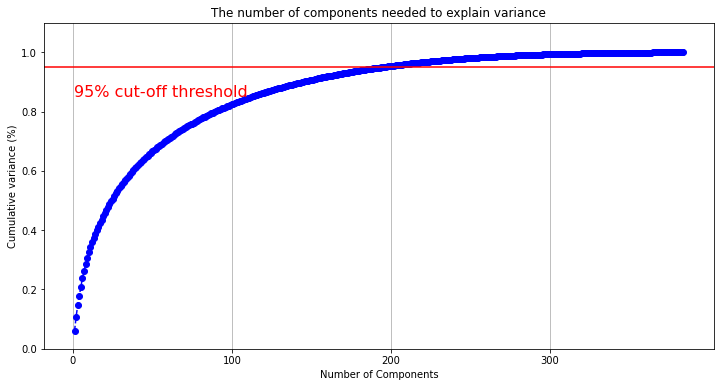

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (12,6)

fig, ax = plt.subplots()
xi = np.arange(1, n_pcs+1, step=1)
y = np.cumsum(pca_all_mini_l6v2.explained_variance_ratio_)

plt.ylim(0.0,1.1)
plt.plot(xi, y, marker='o', linestyle='--', color='b')

plt.xlabel('Number of Components')
plt.xticks(np.arange(0, n_pcs, step=100)) #change from 0-based array index to 1-based human-readable label
plt.ylabel('Cumulative variance (%)')
plt.title('The number of components needed to explain variance')

plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)

ax.grid(axis='x')
plt.show()

In [ ]:
pca_all_mini_l6v2 = PCA(n_components=0.95)
principalComponents_all_mini_l6v2 = pca_all_mini_l6v2.fit_transform(scaled_train_set_all_mini_l6v2)
principalComponents_all_mini_l6v2 = pd.DataFrame(principalComponents_all_mini_l6v2)
principalComponents_all_mini_l6v2.shape

(5403, 195)

In [ ]:
principalComponents_all_mini_l6v2["paper_published_conference"] = loaded_train_set["paper_published_conference"]
principalComponents_all_mini_l6v2["cited_paper_published_conference"] = loaded_train_set["cited_paper_published_conference"]

In [ ]:
principalComponents_all_mini_l6v2.head()

,0,1,2,3,4,5,6,7,8,9,...,187,188,189,190,191,192,193,194,paper_published_conference,cited_paper_published_conference
0,8.090474,1.430712,0.843396,6.964088,-1.326775,0.285524,-0.641112,-3.774457,-0.914855,-1.549833,...,-0.621837,0.209772,-0.650405,-0.301578,0.450656,-0.232183,2.374801,-0.643799,914,117
1,-1.281083,-1.607533,0.582203,3.921819,0.872680,-6.283094,2.125396,0.856769,0.868311,1.365212,...,-0.616771,0.370018,0.094496,0.316780,-0.173118,-0.180037,0.411047,0.143981,5,4
2,5.326117,-4.311395,0.780015,3.593155,1.525789,0.422389,4.321023,2.360551,-4.765782,3.626931,...,0.241410,-0.959146,0.581069,0.530530,1.265493,-0.686540,0.338428,0.611782,547,229
3,3.236503,-5.185720,-0.798197,0.488088,1.210001,-2.610764,-0.499894,-5.755859,-0.349773,-2.899436,...,-0.819925,0.212003,-0.528561,0.333901,-0.094862,0.632806,0.958017,1.459326,781,378
4,-3.186205,3.742327,5.961839,6.130187,1.159824,7.938367,1.288204,-2.478031,1.863382,-0.906549,...,0.198579,-0.037415,-0.296426,-0.018846,-0.202662,-0.047451,0.291539,-0.262016,601,154


In [4]:
#principalComponents_all_mini_l6v2.to_csv("train_set_final_all-MiniLM-L6-v2.tsv", sep='\t')
principalComponents_all_mini_l6v2 = pd.read_csv("train_set_final_all-MiniLM-L6-v2.tsv", sep='\t')
principalComponents_all_mini_l6v2.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_mini_l6v2.shape

(5403, 197)

In [5]:
#principalComponents_all_mini_l6v2_test = pca_all_mini_l6v2.transform(scaled_test_set_all_mini_l6v2)
#principalComponents_all_mini_l6v2_test = pd.DataFrame(principalComponents_all_mini_l6v2_test)
#principalComponents_all_mini_l6v2_test["paper_published_conference"] = loaded_test_set["paper_published_conference"]
#principalComponents_all_mini_l6v2_test["cited_paper_published_conference"] = loaded_test_set["cited_paper_published_conference"]
#principalComponents_all_mini_l6v2_test.to_csv("test_set_final_all-MiniLM-L6-v2.tsv", sep='\t')
principalComponents_all_mini_l6v2_test = pd.read_csv("test_set_final_all-MiniLM-L6-v2.tsv", sep='\t')
principalComponents_all_mini_l6v2_test.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_mini_l6v2_test.shape

(2316, 197)

# Model : all-mpnet-base-v2

In [ ]:
pca_all_mpnet_basev2 = PCA()
pca_result_all_mpnet_basev2 = pca_all_mpnet_basev2.fit_transform((scaled_train_set_all_mpnet_basev2))
print('Cumulative variance explained by principal components: {:.2%}'.format(np.sum(pca_all_mpnet_basev2.explained_variance_ratio_)))
n_pcs= pca_all_mpnet_basev2.components_.shape[0]
print("Number of principal components : {}". format(n_pcs))
print("Shape of principal components : {}". format(pca_all_mpnet_basev2.components_.shape))

Cumulative variance explained by principal components: 100.00%
Number of principal components : 768
Shape of principal components : (768, 768)


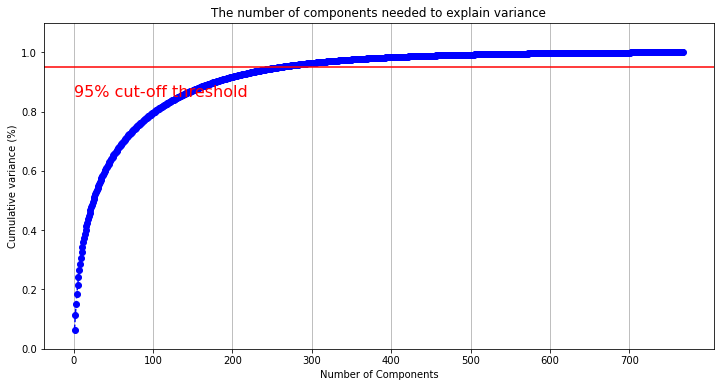

In [ ]:
plt.rcParams["figure.figsize"] = (12,6)

fig, ax = plt.subplots()
xi = np.arange(1, n_pcs+1, step=1)
y = np.cumsum(pca_all_mpnet_basev2.explained_variance_ratio_)

plt.ylim(0.0,1.1)
plt.plot(xi, y, marker='o', linestyle='--', color='b')

plt.xlabel('Number of Components')
plt.xticks(np.arange(0, n_pcs, step=100)) #change from 0-based array index to 1-based human-readable label
plt.ylabel('Cumulative variance (%)')
plt.title('The number of components needed to explain variance')

plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)

ax.grid(axis='x')
plt.show()

In [ ]:
pca_all_mpnet_basev2 = PCA(n_components=0.95)
principalComponents_all_mpnet_basev2 = pca_all_mpnet_basev2.fit_transform(scaled_train_set_all_mpnet_basev2)
principalComponents_all_mpnet_basev2 = pd.DataFrame(principalComponents_all_mpnet_basev2)
principalComponents_all_mpnet_basev2.shape

(5403, 260)

In [ ]:
principalComponents_all_mpnet_basev2["paper_published_conference"] = loaded_train_set["paper_published_conference"]
principalComponents_all_mpnet_basev2["cited_paper_published_conference"] = loaded_train_set["cited_paper_published_conference"]

In [ ]:
#principalComponents_all_mpnet_basev2.to_csv("train_set_final_all_mpnet_basev2.tsv", sep='\t')
principalComponents_all_mpnet_basev2 = pd.read_csv("train_set_final_all_mpnet_basev2.tsv", sep='\t')
principalComponents_all_mpnet_basev2.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_mpnet_basev2.shape

(5403, 262)

In [ ]:
#principalComponents_all_mpnet_basev2_test = pca_all_mpnet_basev2.transform(scaled_test_set_all_mpnet_basev2)
#principalComponents_all_mpnet_basev2_test = pd.DataFrame(principalComponents_all_mpnet_basev2_test)
#principalComponents_all_mpnet_basev2_test["paper_published_conference"] = loaded_test_set["paper_published_conference"]
#principalComponents_all_mpnet_basev2_test["cited_paper_published_conference"] = loaded_test_set["cited_paper_published_conference"]
#principalComponents_all_mpnet_basev2_test.to_csv("test_set_final_all_mpnet_basev2.tsv", sep='\t')
principalComponents_all_mpnet_basev2_test = pd.read_csv("test_set_final_all_mpnet_basev2.tsv", sep='\t')
principalComponents_all_mpnet_basev2_test.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_mpnet_basev2_test.shape

(2316, 262)

# Model : paraphrase-MiniLM-L3-v2

In [ ]:
pca_all_minilm_l3v2 = PCA()
pca_result_all_minilm_l3v2 = pca_all_minilm_l3v2.fit_transform((scaled_train_set_all_minilm_l3v2))
print('Cumulative variance explained by principal components: {:.2%}'.format(np.sum(pca_all_minilm_l3v2.explained_variance_ratio_)))
n_pcs= pca_all_minilm_l3v2.components_.shape[0]
print("Number of principal components : {}". format(n_pcs))
print("Shape of principal components : {}". format(pca_all_minilm_l3v2.components_.shape))

Cumulative variance explained by principal components: 100.00%
Number of principal components : 384
Shape of principal components : (384, 384)


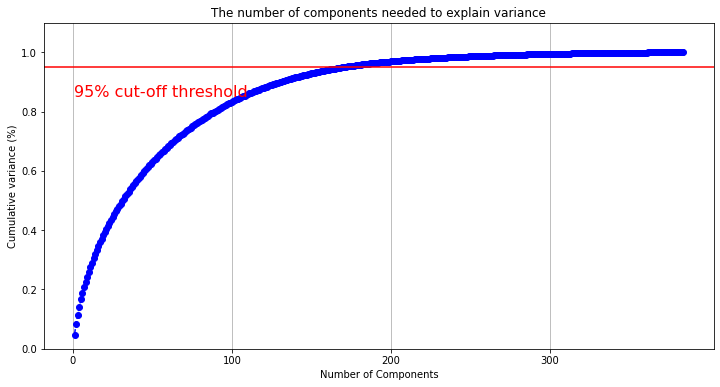

In [ ]:
plt.rcParams["figure.figsize"] = (12,6)

fig, ax = plt.subplots()
xi = np.arange(1, n_pcs+1, step=1)
y = np.cumsum(pca_all_minilm_l3v2.explained_variance_ratio_)

plt.ylim(0.0,1.1)
plt.plot(xi, y, marker='o', linestyle='--', color='b')

plt.xlabel('Number of Components')
plt.xticks(np.arange(0, n_pcs, step=100)) #change from 0-based array index to 1-based human-readable label
plt.ylabel('Cumulative variance (%)')
plt.title('The number of components needed to explain variance')

plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.85, '95% cut-off threshold', color = 'red', fontsize=16)

ax.grid(axis='x')
plt.show()

In [ ]:
pca_all_minilm_l3v2 = PCA(n_components=0.95)
principalComponents_all_minilm_l3v2 = pca_all_minilm_l3v2.fit_transform(scaled_train_set_all_minilm_l3v2)
principalComponents_all_minilm_l3v2 = pd.DataFrame(principalComponents_all_minilm_l3v2)
principalComponents_all_minilm_l3v2.shape

(5403, 171)

In [ ]:
principalComponents_all_minilm_l3v2["paper_published_conference"] = loaded_train_set["paper_published_conference"]
principalComponents_all_minilm_l3v2["cited_paper_published_conference"] = loaded_train_set["cited_paper_published_conference"]

In [ ]:
#principalComponents_all_minilm_l3v2.to_csv("train_set_final_all_minilm_l3v2.tsv", sep='\t')
principalComponents_all_minilm_l3v2 = pd.read_csv("train_set_final_all_minilm_l3v2.tsv", sep='\t')
principalComponents_all_minilm_l3v2.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_minilm_l3v2.shape

(5403, 173)

In [ ]:
#principalComponents_all_minilm_l3v2_test = pca_all_minilm_l3v2.transform(scaled_test_set_all_minilm_l3v2)
#principalComponents_all_minilm_l3v2_test = pd.DataFrame(principalComponents_all_minilm_l3v2_test)
#principalComponents_all_minilm_l3v2_test["paper_published_conference"] = loaded_test_set["paper_published_conference"]
#principalComponents_all_minilm_l3v2_test["cited_paper_published_conference"] = loaded_test_set["cited_paper_published_conference"]
#principalComponents_all_minilm_l3v2_test.to_csv("test_set_final_all_minilm_l3v2.tsv", sep='\t')
principalComponents_all_minilm_l3v2_test = pd.read_csv("test_set_final_all_minilm_l3v2.tsv", sep='\t')
principalComponents_all_minilm_l3v2_test.drop(columns = 'Unnamed: 0', axis = 1, inplace= True)
principalComponents_all_minilm_l3v2_test.shape

(2316, 173)

# Clustering

## DBSCAN

In [ ]:
def dbscan_predict(model, X):
    nr_samples = X.shape[0]
    y_new = np.ones(shape=nr_samples, dtype=int) * -1
    for i in range(nr_samples):
        diff = model.components_ - list(X.iloc[i, :])  # NumPy broadcasting
        dist = np.linalg.norm(diff, axis=1)  # Euclidean distance

        shortest_dist_idx = np.argmin(dist)

        if dist[shortest_dist_idx] < model.eps:
            y_new[i] = model.labels_[model.core_sample_indices_[shortest_dist_idx]]

    return y_new

In [ ]:
def dbscan_predict_manhattan(model, X):
  nr_samples = X.shape[0]
  y_new = np.ones(shape=nr_samples, dtype=int) * -1
  for i in range(nr_samples):
    
    diff = abs(model.components_ - list(X.iloc[i, :]))  # NumPy broadcasting
    dist = np.ones(shape=diff.shape[0], dtype=float) 
    for j in range(diff.shape[0]):
      dist[j] = sum(diff[i,:]) 
    shortest_dist_idx = np.argmin(dist)
    
    if dist[shortest_dist_idx] < model.eps:
      y_new[i] = model.labels_[model.core_sample_indices_[shortest_dist_idx]]
  return y_new

### Model : all-MiniLM-L6-v2

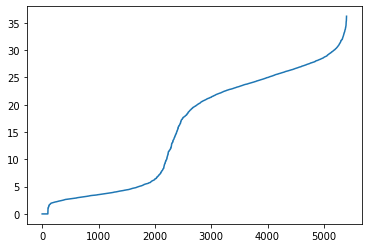

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='euclidean')
nbrs = neigh.fit(principalComponents_all_mini_l6v2)
distances, indices = nbrs.kneighbors(principalComponents_all_mini_l6v2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_mini_l6v2 = DBSCAN(eps=30, min_samples=5).fit(principalComponents_all_mini_l6v2) 
labels = dbscan_predict(DBSCAN_cluster_all_mini_l6v2, principalComponents_all_mini_l6v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,DBSCAN_cluster_all_mini_l6v2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, DBSCAN_cluster_all_mini_l6v2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  233.07021291643704
silhouette score of model on train data:  -0.10219150043241633


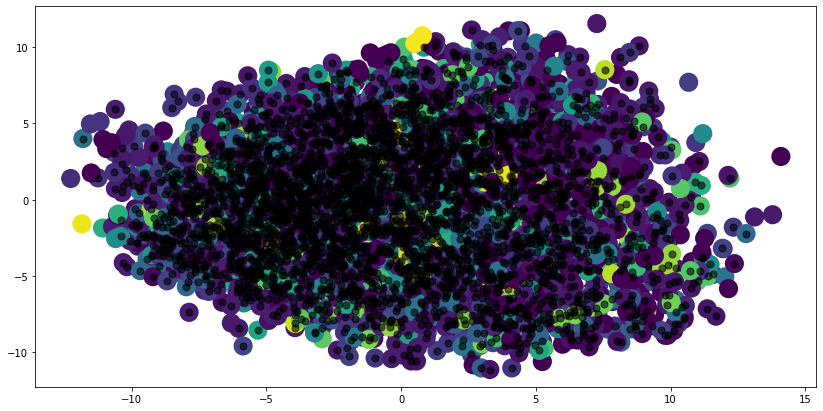

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=DBSCAN_cluster_all_mini_l6v2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mini_l6v2.labels_)))

Number of cluster:  131


In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels, metric='euclidean'))

calinski harabasz score of model on test data:  71.81123887916081
silhouette score of model on test data:  -0.14395007021252795


In [ ]:
print("Number of cluster: ",len(np.unique(labels)))

Number of cluster:  129


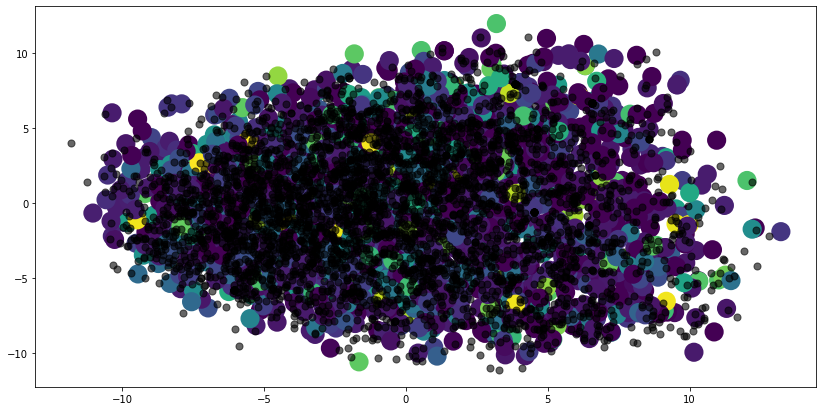

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_30_5_all_mini_l6v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mini_l6v2, f)

In [ ]:
DBSCAN_cluster_all_mini_l6v2_2 = DBSCAN(eps=32, min_samples=5).fit(principalComponents_all_mini_l6v2) 
labels_2 = dbscan_predict(DBSCAN_cluster_all_mini_l6v2_2, principalComponents_all_mini_l6v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,DBSCAN_cluster_all_mini_l6v2_2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, DBSCAN_cluster_all_mini_l6v2_2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  275.3783394116588
silhouette score of model on train data:  -0.38797350696847616


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mini_l6v2_2.labels_)))

Number of cluster:  54


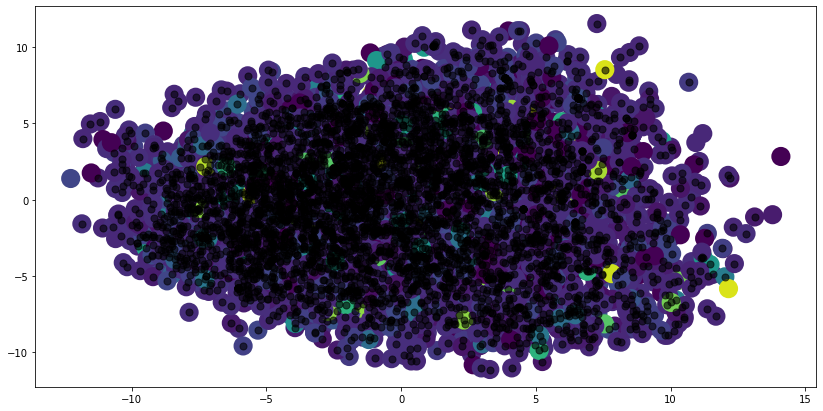

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=DBSCAN_cluster_all_mini_l6v2_2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_2 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_2, metric='euclidean'))

calinski harabasz score of model on test data:  116.73779598784054
silhouette score of model on test data:  -0.38267755592083197


In [ ]:
print("Number of cluster: ",len(np.unique(labels_2)))

Number of cluster:  53


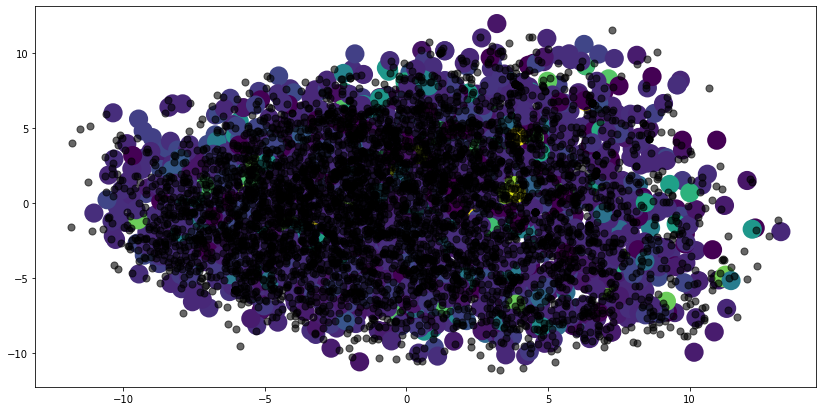

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_32_5_all_mini_l6v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mini_l6v2_2, f)

In [ ]:
DBSCAN_cluster_all_mini_l6v2_3 = DBSCAN(eps=28, min_samples=5).fit(principalComponents_all_mini_l6v2) 
labels_3 = dbscan_predict(DBSCAN_cluster_all_mini_l6v2_3, principalComponents_all_mini_l6v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,DBSCAN_cluster_all_mini_l6v2_3.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, DBSCAN_cluster_all_mini_l6v2_3.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  58.58316934678793
silhouette score of model on train data:  -0.1095264682621987


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mini_l6v2_3.labels_)))

Number of cluster:  229


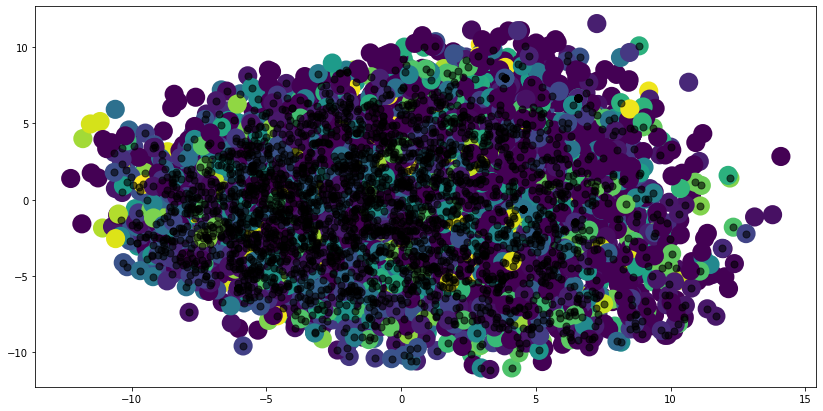

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=DBSCAN_cluster_all_mini_l6v2_3.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_3 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_3, metric='euclidean'))

calinski harabasz score of model on test data:  18.229567543145535
silhouette score of model on test data:  -0.22123143375664833


In [ ]:
print("Number of cluster: ",len(np.unique(labels_3)))

Number of cluster:  202


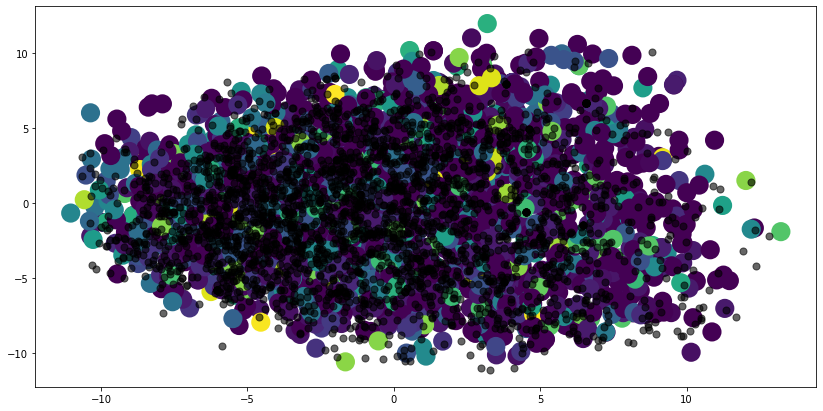

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_28_5_all_mini_l6v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mini_l6v2_3, f)

In [ ]:
for i in range(2,15):
  DBSCAN_cluster_all_mini_l6v2_min_samp = DBSCAN(eps=30, min_samples=i).fit(principalComponents_all_mini_l6v2) 
  print("calinski harabasz score of model with min_samples as {min}: {ch} ".format(min=i, ch= metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,DBSCAN_cluster_all_mini_l6v2_min_samp.labels_ )) )
  print("silhouette score of model with min_samples as {min}: {ss}".format(min = i, ss= metrics.silhouette_score(principalComponents_all_mini_l6v2, DBSCAN_cluster_all_mini_l6v2_min_samp.labels_ , metric='euclidean')) )


calinski harabasz score of model with min_samples as 2: 183.2627394113066 
silhouette score of model with min_samples as 2: -0.260876807921546
calinski harabasz score of model with min_samples as 3: 216.55626940820505 
silhouette score of model with min_samples as 3: -0.24162956367336588
calinski harabasz score of model with min_samples as 4: 255.42215854972943 
silhouette score of model with min_samples as 4: -0.1800692057598378
calinski harabasz score of model with min_samples as 5: 233.07021291643704 
silhouette score of model with min_samples as 5: -0.10219150043241633
calinski harabasz score of model with min_samples as 6: 180.49120482740398 
silhouette score of model with min_samples as 6: -0.10385916568279625
calinski harabasz score of model with min_samples as 7: 136.25534881490194 
silhouette score of model with min_samples as 7: -0.10052980552321712
calinski harabasz score of model with min_samples as 8: 119.23753484383063 
silhouette score of model with min_samples as 8: -0.

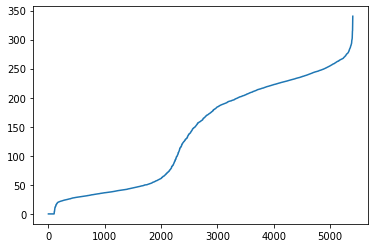

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='manhattan')
nbrs = neigh.fit(principalComponents_all_mini_l6v2)
distances, indices = nbrs.kneighbors(principalComponents_all_mini_l6v2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_mini_l6v2_manhattan= DBSCAN(eps=280, min_samples=5, metric="manhattan").fit(principalComponents_all_mini_l6v2) 
labels_manhattan = dbscan_predict_manhattan(DBSCAN_cluster_all_mini_l6v2_manhattan, principalComponents_all_mini_l6v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,DBSCAN_cluster_all_mini_l6v2_manhattan.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, DBSCAN_cluster_all_mini_l6v2_manhattan.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  3.371764904069686
silhouette score of model on train data:  -0.28356295556544897


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mini_l6v2_manhattan.labels_)))

Number of cluster:  4


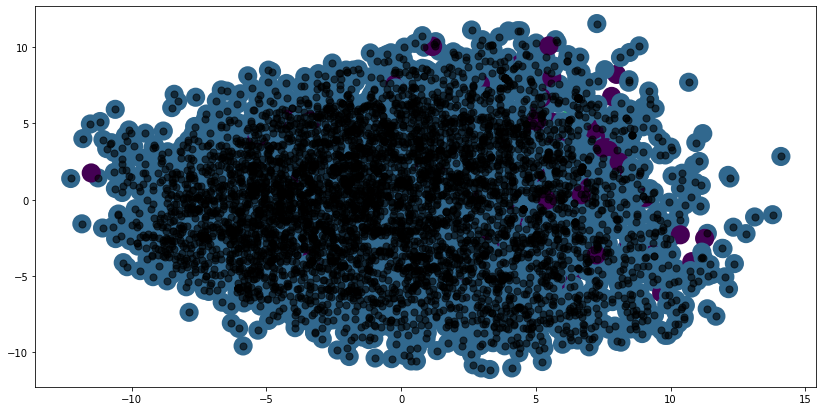

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=DBSCAN_cluster_all_mini_l6v2_manhattan.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_manhattan ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_manhattan, metric='euclidean'))

calinski harabasz score of model on test data:  0.4975057135450694
silhouette score of model on test data:  -0.04868580554933721


In [ ]:
print("Number of cluster: ",len(np.unique(labels_manhattan)))

Number of cluster:  2


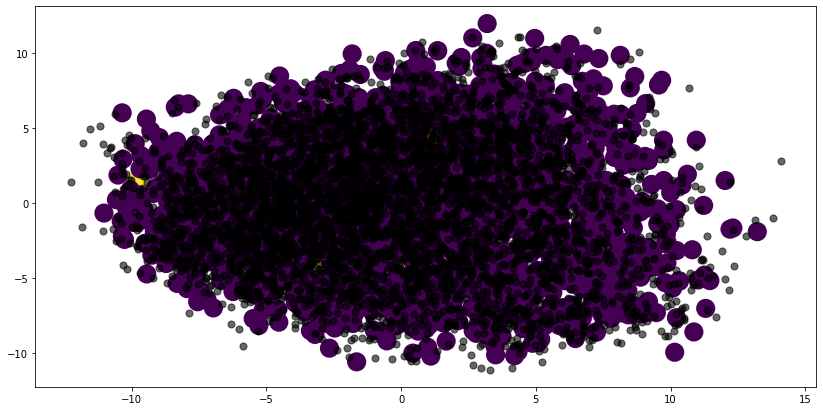

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_manhattan , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mini_l6v2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_manhattan_280_5_all_mini_l6v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mini_l6v2_manhattan, f)

### Model : all-mpnet-base-v2

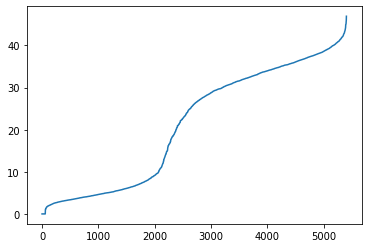

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='euclidean')
nbrs = neigh.fit(principalComponents_all_mpnet_basev2)
distances, indices = nbrs.kneighbors(principalComponents_all_mpnet_basev2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_mpnet_basev2 = DBSCAN(eps=38, min_samples=5).fit(principalComponents_all_mpnet_basev2) 
labels = dbscan_predict(DBSCAN_cluster_all_mpnet_basev2, principalComponents_all_mpnet_basev2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  103.03096395107768
silhouette score of model on train data:  -0.2198713142619887


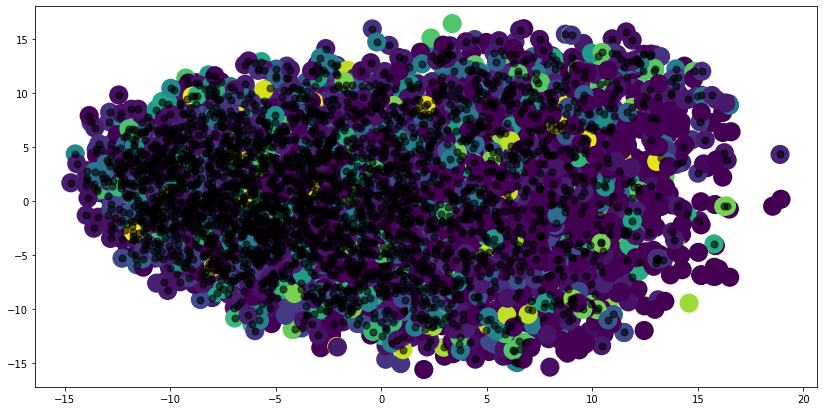

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=DBSCAN_cluster_all_mpnet_basev2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mpnet_basev2.labels_)))

Number of cluster:  149


In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels, metric='euclidean'))

calinski harabasz score of model on test data:  38.54515003205078
silhouette score of model on test data:  -0.2579208481616342


In [ ]:
print("Number of cluster: ",len(np.unique(labels)))

Number of cluster:  137


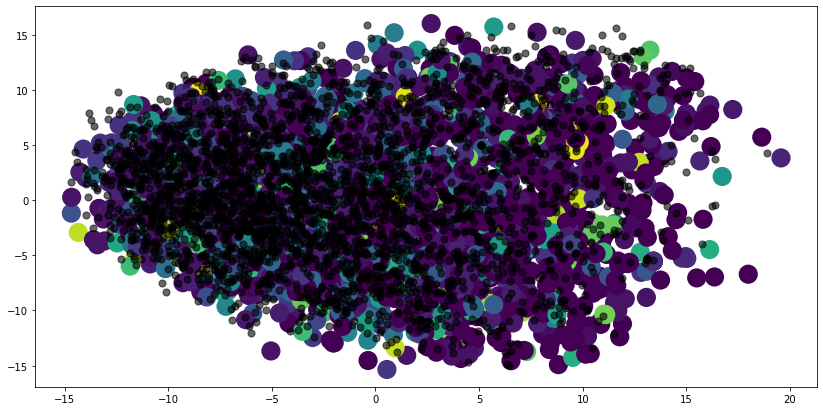

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_38_5_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mpnet_basev2, f)

In [ ]:
DBSCAN_cluster_all_mpnet_basev2_2 = DBSCAN(eps=40, min_samples=5).fit(principalComponents_all_mpnet_basev2) 
labels_2 = dbscan_predict(DBSCAN_cluster_all_mpnet_basev2_2, principalComponents_all_mpnet_basev2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2_2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2_2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  127.09797958264458
silhouette score of model on train data:  -0.47684807545776337


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mpnet_basev2_2.labels_)))

Number of cluster:  64


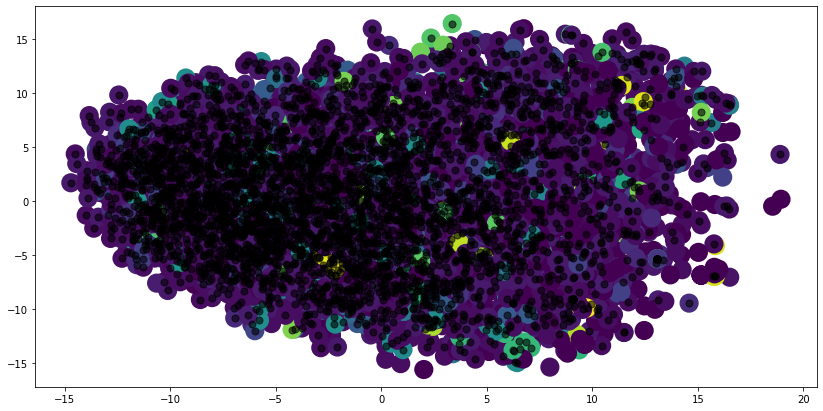

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=DBSCAN_cluster_all_mpnet_basev2_2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_2 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_2, metric='euclidean'))

calinski harabasz score of model on test data:  55.26839581078649
silhouette score of model on test data:  -0.4843459309807578


In [ ]:
print("Number of cluster: ",len(np.unique(labels_2)))

Number of cluster:  60


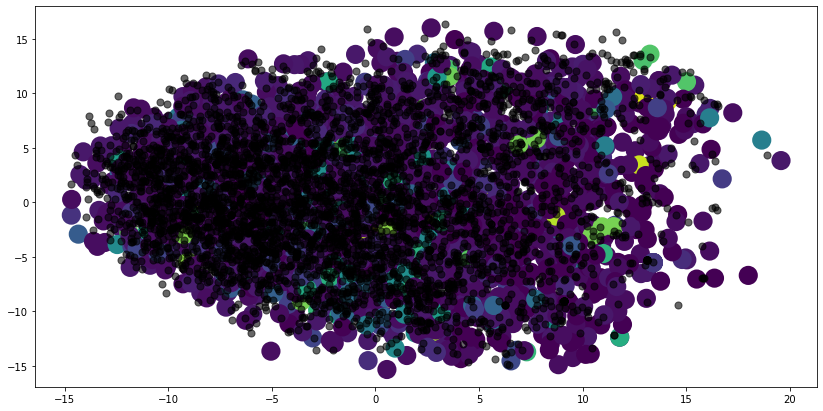

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_40_5_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mpnet_basev2_2, f)

In [ ]:
DBSCAN_cluster_all_mpnet_basev2_3 = DBSCAN(eps=42, min_samples=5).fit(principalComponents_all_mpnet_basev2) 
labels_3 = dbscan_predict(DBSCAN_cluster_all_mpnet_basev2_3, principalComponents_all_mpnet_basev2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2_3.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2_3.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  17.226006777637142
silhouette score of model on train data:  -0.5198244066650235


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mpnet_basev2_3.labels_)))

Number of cluster:  17


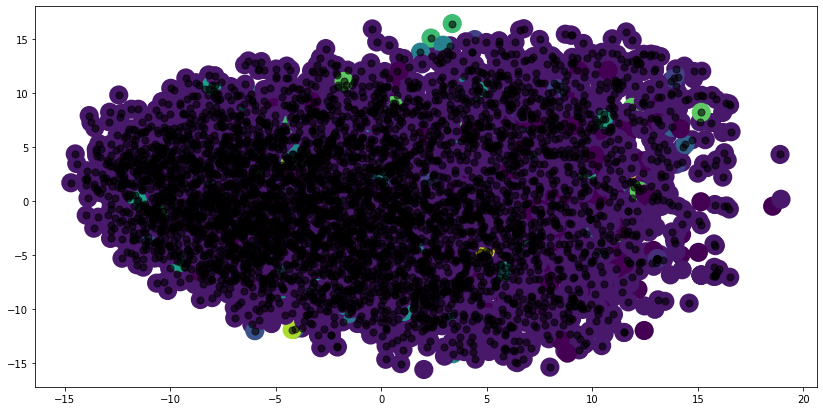

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=DBSCAN_cluster_all_mpnet_basev2_3.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_3 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_3, metric='euclidean'))

calinski harabasz score of model on test data:  8.349952563097391
silhouette score of model on test data:  -0.5066829203615214


In [ ]:
print("Number of cluster: ",len(np.unique(labels_3)))

Number of cluster:  15


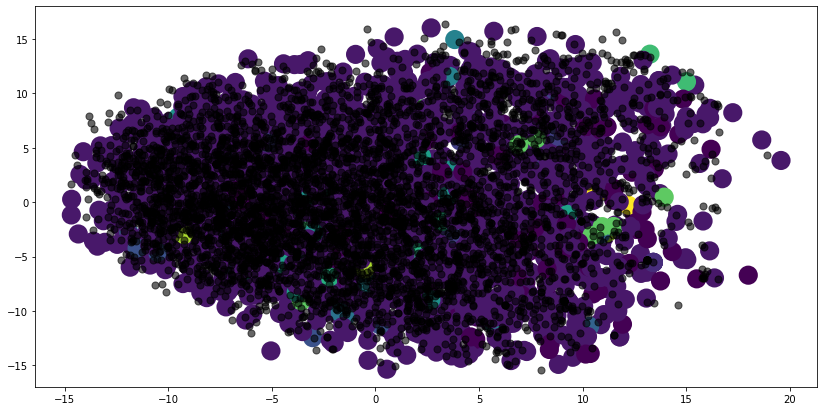

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_42_5_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mpnet_basev2_3, f)

In [ ]:
DBSCAN_cluster_all_mpnet_basev2_4 = DBSCAN(eps=37, min_samples=5).fit(principalComponents_all_mpnet_basev2) 
labels_4 = dbscan_predict(DBSCAN_cluster_all_mpnet_basev2_4, principalComponents_all_mpnet_basev2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2_4.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2_4.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  63.11971708383651
silhouette score of model on train data:  -0.191560289571726


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mpnet_basev2_4.labels_)))

Number of cluster:  178


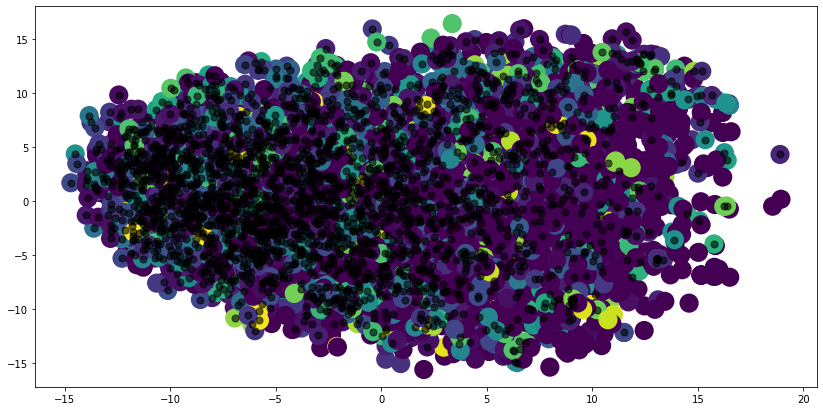

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=DBSCAN_cluster_all_mpnet_basev2_4.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_4.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_4 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_4, metric='euclidean'))

calinski harabasz score of model on test data:  23.170762342661437
silhouette score of model on test data:  -0.2612296604464783


In [ ]:
print("Number of cluster: ",len(np.unique(labels_4)))

Number of cluster:  160


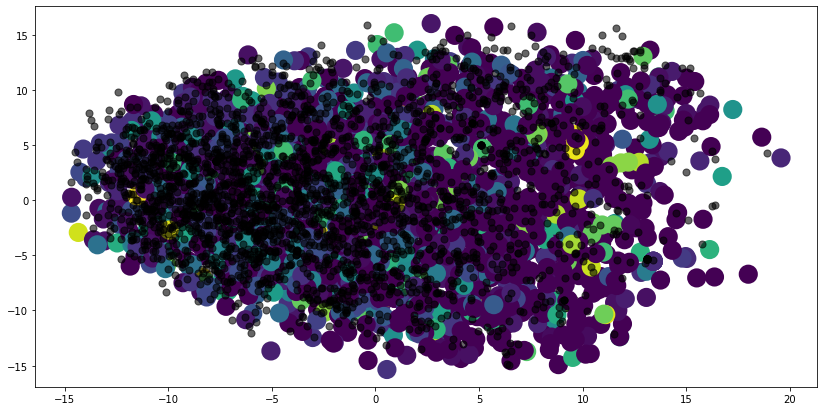

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_4 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_4.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_37_5_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mpnet_basev2_4, f)

In [ ]:
for i in range(2,15):
  DBSCAN_cluster_all_mpnet_basev2_min_samp = DBSCAN(eps=38, min_samples=i).fit(principalComponents_all_mpnet_basev2) 
  print("calinski harabasz score of model with min_samples as {min}: {ch} ".format(min=i, ch= metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2_min_samp.labels_ )) )
  print("silhouette score of model with min_samples as {min}: {ss}".format(min = i, ss= metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2_min_samp.labels_ , metric='euclidean')) )


calinski harabasz score of model with min_samples as 2: 88.81309628800183 
silhouette score of model with min_samples as 2: -0.23292348829520798
calinski harabasz score of model with min_samples as 3: 109.33486451416314 
silhouette score of model with min_samples as 3: -0.2599257013261994
calinski harabasz score of model with min_samples as 4: 113.17868036715805 
silhouette score of model with min_samples as 4: -0.23897154895737915
calinski harabasz score of model with min_samples as 5: 103.03096395107768 
silhouette score of model with min_samples as 5: -0.2198713142619887
calinski harabasz score of model with min_samples as 6: 89.80091331709963 
silhouette score of model with min_samples as 6: -0.22062872929630065
calinski harabasz score of model with min_samples as 7: 82.35990722304089 
silhouette score of model with min_samples as 7: -0.21197735638032728
calinski harabasz score of model with min_samples as 8: 72.99069076717733 
silhouette score of model with min_samples as 8: -0.22

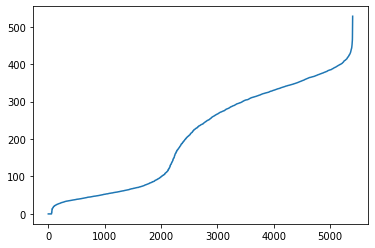

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='manhattan')
nbrs = neigh.fit(principalComponents_all_mpnet_basev2)
distances, indices = nbrs.kneighbors(principalComponents_all_mpnet_basev2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_mpnet_basev2_manhattan= DBSCAN(eps=420, min_samples=5, metric="manhattan").fit(principalComponents_all_mpnet_basev2) 
labels_manhattan = dbscan_predict_manhattan(DBSCAN_cluster_all_mpnet_basev2_manhattan, principalComponents_all_mpnet_basev2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,DBSCAN_cluster_all_mpnet_basev2_manhattan.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, DBSCAN_cluster_all_mpnet_basev2_manhattan.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  5.190611150240858
silhouette score of model on train data:  -0.4328854737907215


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_mpnet_basev2_manhattan.labels_)))

Number of cluster:  5


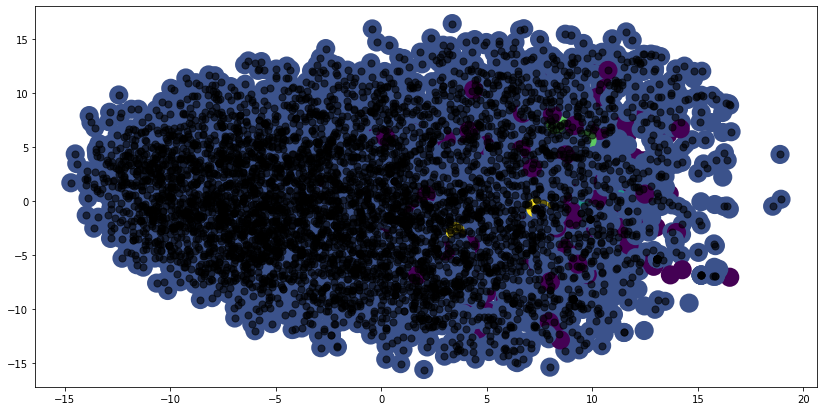

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=DBSCAN_cluster_all_mpnet_basev2_manhattan.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_manhattan ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_manhattan, metric='euclidean'))

calinski harabasz score of model on test data:  0.7460434052413261
silhouette score of model on test data:  0.010042052606612771


In [ ]:
print("Number of cluster: ",len(np.unique(labels_manhattan)))

Number of cluster:  2


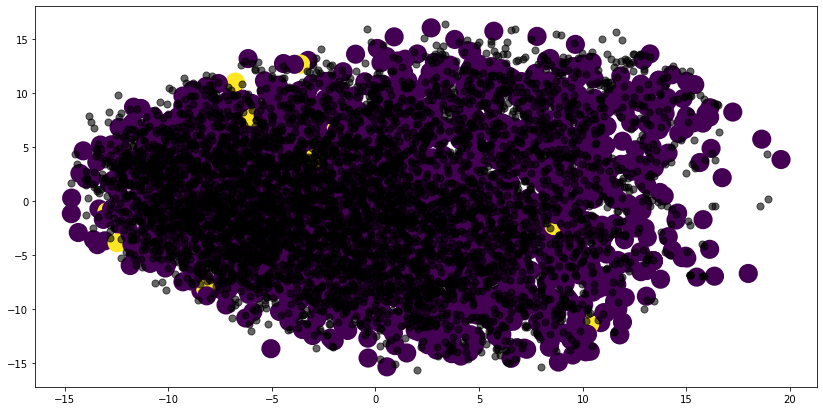

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_manhattan , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_mpnet_basev2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_manhattan_420_5_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_mpnet_basev2_manhattan, f)

### Model : paraphrase-MiniLM-L3-v2

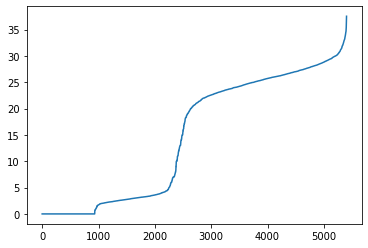

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='euclidean')
nbrs = neigh.fit(principalComponents_all_minilm_l3v2)
distances, indices = nbrs.kneighbors(principalComponents_all_minilm_l3v2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_minilm_l3v2 = DBSCAN(eps=30, min_samples=5).fit(principalComponents_all_minilm_l3v2) 
labels = dbscan_predict(DBSCAN_cluster_all_minilm_l3v2, principalComponents_all_minilm_l3v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,DBSCAN_cluster_all_minilm_l3v2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, DBSCAN_cluster_all_minilm_l3v2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  196.84573737362615
silhouette score of model on train data:  -0.13164313845239478


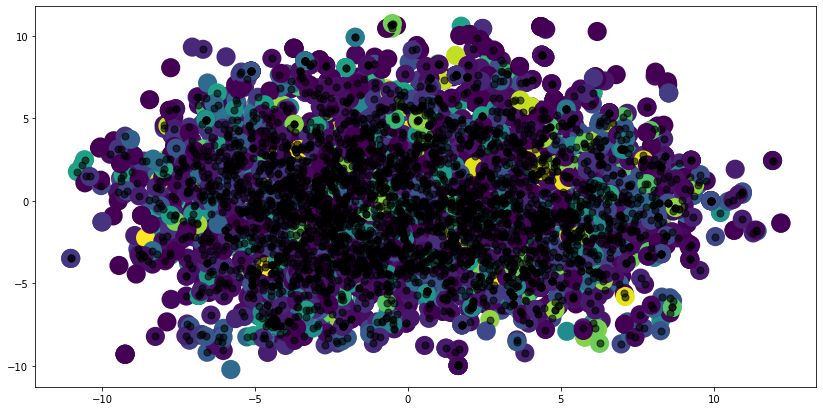

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=DBSCAN_cluster_all_minilm_l3v2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_minilm_l3v2.labels_)))

Number of cluster:  141


In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels, metric='euclidean'))

calinski harabasz score of model on test data:  71.35795490218337
silhouette score of model on test data:  -0.14917598984130426


In [ ]:
print("Number of cluster: ",len(np.unique(labels)))

Number of cluster:  132


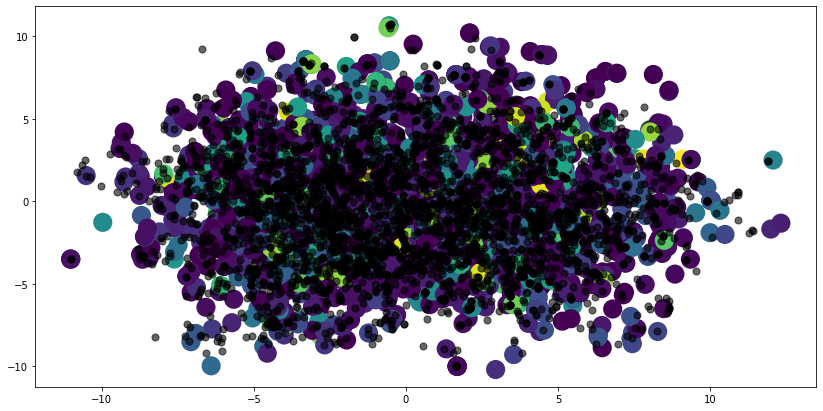

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_30_5_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_minilm_l3v2, f)

In [ ]:
DBSCAN_cluster_all_minilm_l3v2_2 = DBSCAN(eps=32, min_samples=5).fit(principalComponents_all_minilm_l3v2) 
labels_2 = dbscan_predict(DBSCAN_cluster_all_minilm_l3v2_2, principalComponents_all_minilm_l3v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,DBSCAN_cluster_all_minilm_l3v2_2.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, DBSCAN_cluster_all_minilm_l3v2_2.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  302.47640867636676
silhouette score of model on train data:  -0.4057034456072003


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_minilm_l3v2_2.labels_)))

Number of cluster:  51


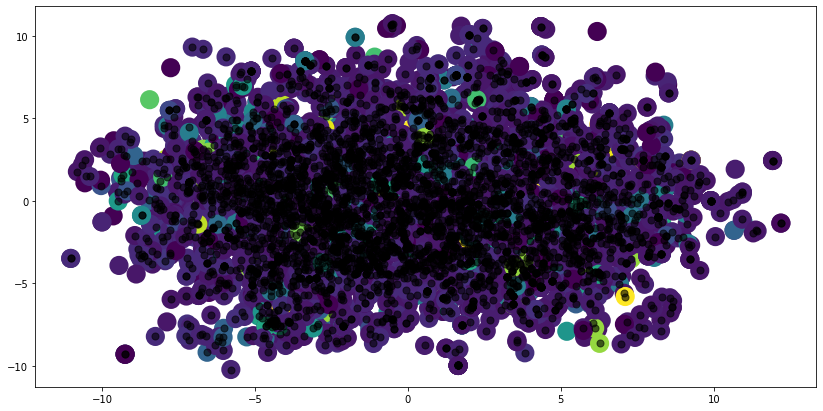

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=DBSCAN_cluster_all_minilm_l3v2_2.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_2 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_2, metric='euclidean'))

calinski harabasz score of model on test data:  122.3426987817873
silhouette score of model on test data:  -0.4121495640064079


In [ ]:
print("Number of cluster: ",len(np.unique(labels_2)))

Number of cluster:  50


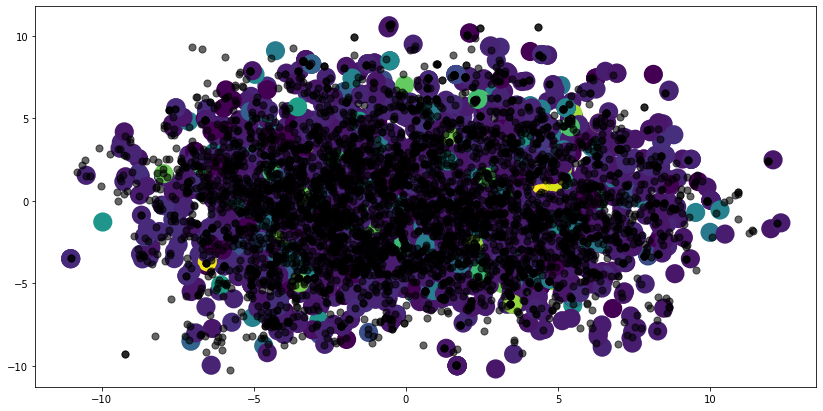

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_2.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_32_5_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_minilm_l3v2_2, f)

In [ ]:
DBSCAN_cluster_all_minilm_l3v2_3 = DBSCAN(eps=28, min_samples=5).fit(principalComponents_all_minilm_l3v2) 
labels_3 = dbscan_predict(DBSCAN_cluster_all_minilm_l3v2_3, principalComponents_all_minilm_l3v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,DBSCAN_cluster_all_minilm_l3v2_3.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, DBSCAN_cluster_all_minilm_l3v2_3.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  44.765259487569246
silhouette score of model on train data:  -0.11078813701999973


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_minilm_l3v2_3.labels_)))

Number of cluster:  252


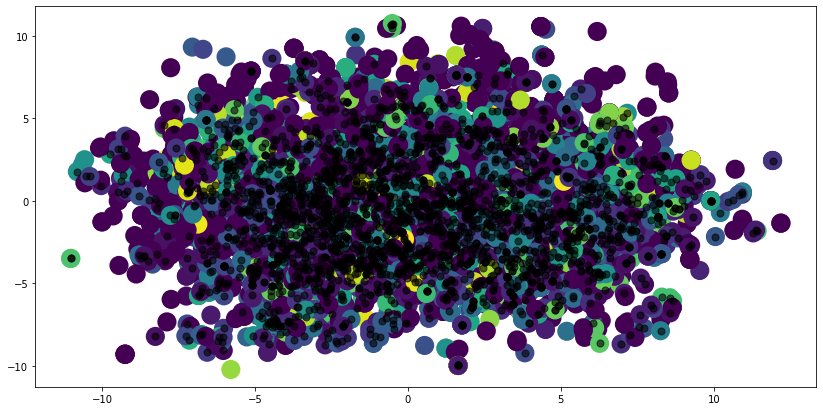

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=DBSCAN_cluster_all_minilm_l3v2_3.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_3 ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_3, metric='euclidean'))

calinski harabasz score of model on test data:  15.10888293746671
silhouette score of model on test data:  -0.19750133763422129


In [ ]:
print("Number of cluster: ",len(np.unique(labels_3)))

Number of cluster:  230


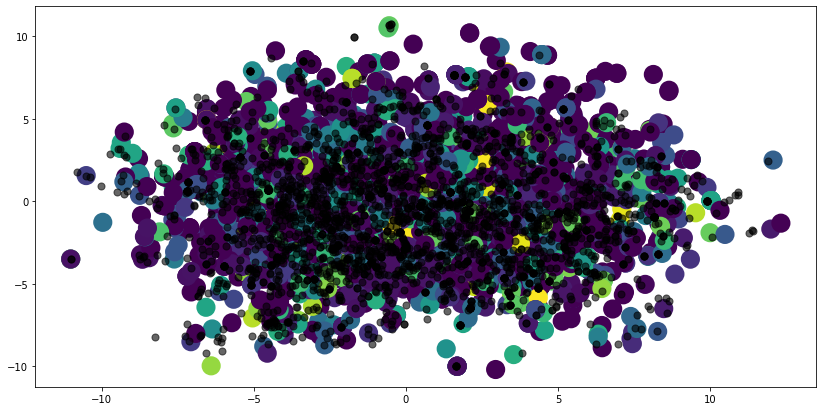

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_3.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_28_5_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_minilm_l3v2_3, f)

In [ ]:
for i in range(2,15):
  DBSCAN_cluster_all_minilm_l3v2_min_samp = DBSCAN(eps=30, min_samples=i).fit(principalComponents_all_minilm_l3v2) 
  print("calinski harabasz score of model with min_samples as {min}: {ch} ".format(min=i, ch= metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,DBSCAN_cluster_all_minilm_l3v2_min_samp.labels_ )) )
  print("silhouette score of model with min_samples as {min}: {ss}".format(min = i, ss= metrics.silhouette_score(principalComponents_all_minilm_l3v2, DBSCAN_cluster_all_minilm_l3v2_min_samp.labels_ , metric='euclidean')) )


calinski harabasz score of model with min_samples as 2: 210.9695915578895 
silhouette score of model with min_samples as 2: -0.2776463956651138
calinski harabasz score of model with min_samples as 3: 237.66959595520316 
silhouette score of model with min_samples as 3: -0.2647885746618765
calinski harabasz score of model with min_samples as 4: 242.87994132076082 
silhouette score of model with min_samples as 4: -0.1759756717947071
calinski harabasz score of model with min_samples as 5: 196.84573737362615 
silhouette score of model with min_samples as 5: -0.13164313845239478
calinski harabasz score of model with min_samples as 6: 149.92838606361383 
silhouette score of model with min_samples as 6: -0.07246301985279548
calinski harabasz score of model with min_samples as 7: 117.55842252484352 
silhouette score of model with min_samples as 7: -0.06620432353956053
calinski harabasz score of model with min_samples as 8: 96.86203121055699 
silhouette score of model with min_samples as 8: -0.1

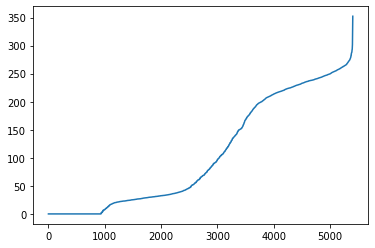

In [ ]:
#https://stats.stackexchange.com/questions/406587/determining-epsilon-for-dbscan
#https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc

neigh = NearestNeighbors(n_neighbors=2, metric='manhattan')
nbrs = neigh.fit(principalComponents_all_minilm_l3v2)
distances, indices = nbrs.kneighbors(principalComponents_all_minilm_l3v2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [ ]:
DBSCAN_cluster_all_minilm_l3v2_manhattan= DBSCAN(eps=270, min_samples=5, metric="manhattan").fit(principalComponents_all_minilm_l3v2) 
labels_manhattan = dbscan_predict_manhattan(DBSCAN_cluster_all_minilm_l3v2_manhattan, principalComponents_all_minilm_l3v2_test)

print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,DBSCAN_cluster_all_minilm_l3v2_manhattan.labels_ ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, DBSCAN_cluster_all_minilm_l3v2_manhattan.labels_ , metric='euclidean'))


calinski harabasz score of model on train data:  5.787240199111394
silhouette score of model on train data:  -0.465064258441267


In [ ]:
print("Number of cluster: ",len(np.unique(DBSCAN_cluster_all_minilm_l3v2_manhattan.labels_)))

Number of cluster:  8


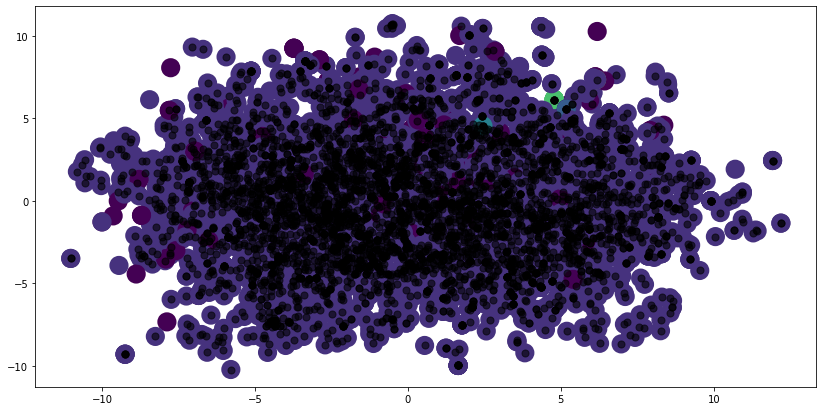

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=DBSCAN_cluster_all_minilm_l3v2_manhattan.labels_ , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
print("calinski harabasz score of model on test data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_manhattan ))
print("silhouette score of model on test data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_manhattan, metric='euclidean'))

calinski harabasz score of model on test data:  0.03754587300148503
silhouette score of model on test data:  -0.036431309976024846


In [ ]:
print("Number of cluster: ",len(np.unique(labels_manhattan)))

Number of cluster:  2


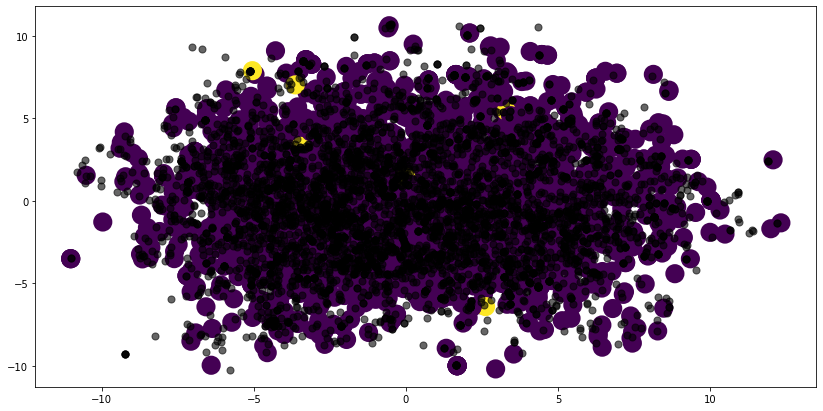

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_manhattan , s=200, cmap='viridis', linewidths=5)

centers = DBSCAN_cluster_all_minilm_l3v2_manhattan.components_
plt.scatter(centers[:, 0], centers[:, 1],c='black', s=50, alpha=0.6);

In [ ]:
with open('dbscan_manhattan_270_5_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(DBSCAN_cluster_all_minilm_l3v2_manhattan, f)

## Gaussian Mixture

### Model : all-MiniLM-L6-v2

In [ ]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
K = np.arange(200, 800, 50)
  
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(principalComponents_all_mini_l6v2)
    kmeanModel.fit(principalComponents_all_mini_l6v2)
  
    distortions.append(sum(np.min(cdist(principalComponents_all_mini_l6v2, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / principalComponents_all_mini_l6v2.shape[0])
    inertias.append(kmeanModel.inertia_)
  
    mapping1[k] = sum(np.min(cdist(principalComponents_all_mini_l6v2, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / principalComponents_all_mini_l6v2.shape[0]
    mapping2[k] = kmeanModel.inertia_

200 : 26.54173552483933
250 : 24.586893073108076
300 : 23.20184406201236
350 : 22.18001570584435
400 : 21.36868676125699
450 : 20.63980793920428
500 : 19.996256181981867
550 : 19.467465893487976
600 : 18.9271450432928
650 : 18.4492972260994
700 : 17.98486656785309
750 : 17.588890981239498


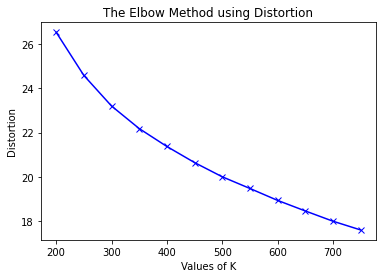

In [ ]:
for key, val in mapping1.items():
    print(f'{key} : {val}')

plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

200 : 4073771.0524296253
250 : 3471631.998388096
300 : 3089074.1067689303
350 : 2817416.436691294
400 : 2608678.058792878
450 : 2444380.1565464465
500 : 2297717.2305366183
550 : 2185614.678081993
600 : 2071707.7033501347
650 : 1982972.832502058
700 : 1900741.0487694636
750 : 1824458.1565430467


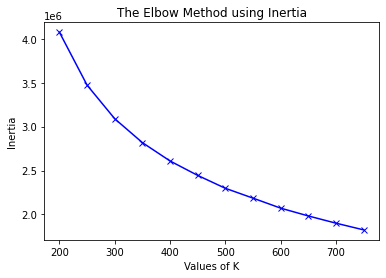

In [ ]:
for key, val in mapping2.items():
    print(f'{key} : {val}')


plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

In [ ]:
int(principalComponents_all_mini_l6v2.shape[0]/5)

1080

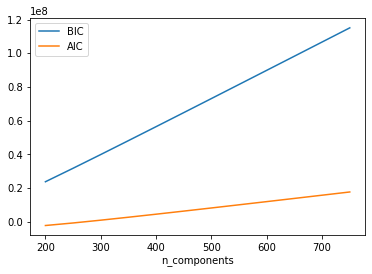

In [ ]:
#run this on local bc of limitations of colab
n_components = np.arange(200, 800, 50)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
          for n in n_components]

plt.plot(n_components, [m.bic(principalComponents_all_mini_l6v2) for m in models], label='BIC')
plt.plot(n_components, [m.aic(principalComponents_all_mini_l6v2) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

In [ ]:
gmm_all_mini_l6v2 = GaussianMixture(n_components=200, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted = gmm_all_mini_l6v2.predict(principalComponents_all_mini_l6v2)
labels = gmm_all_mini_l6v2.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2, fitted ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted , metric='euclidean'))


calinski harabasz score of model on train data:  4663.259130572272
silhouette score of model on train data:  0.2922242401976264


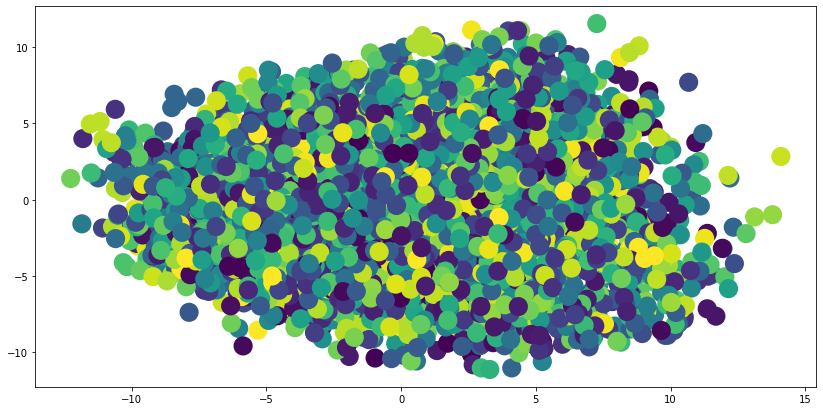

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels , metric='euclidean'))


calinski harabasz score of model on train data:  158.002260935265
silhouette score of model on train data:  -0.04118679080765963


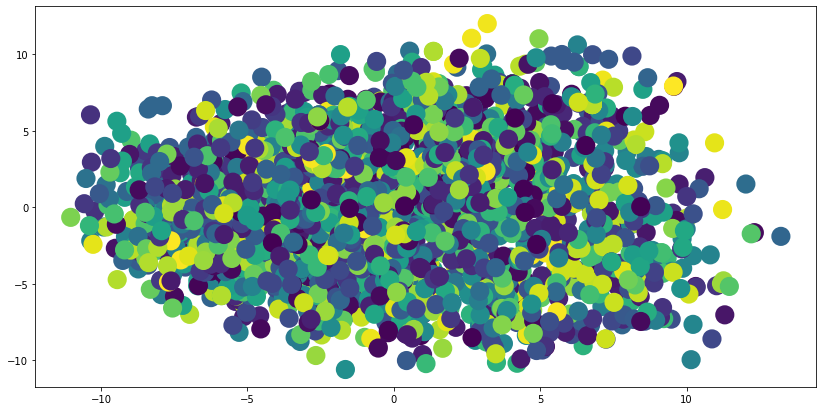

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_200_all_mini_l6v2.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2, f)

In [ ]:
gmm_all_mini_l6v2_2 = GaussianMixture(n_components=200, covariance_type='full', random_state=0, init_params='random').fit(principalComponents_all_mini_l6v2)
fitted_2 = gmm_all_mini_l6v2_2.predict(principalComponents_all_mini_l6v2)
labels_2 = gmm_all_mini_l6v2_2.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_2  , metric='euclidean'))


calinski harabasz score of model on train data:  2.2338683348649075
silhouette score of model on train data:  -0.34276878082791334


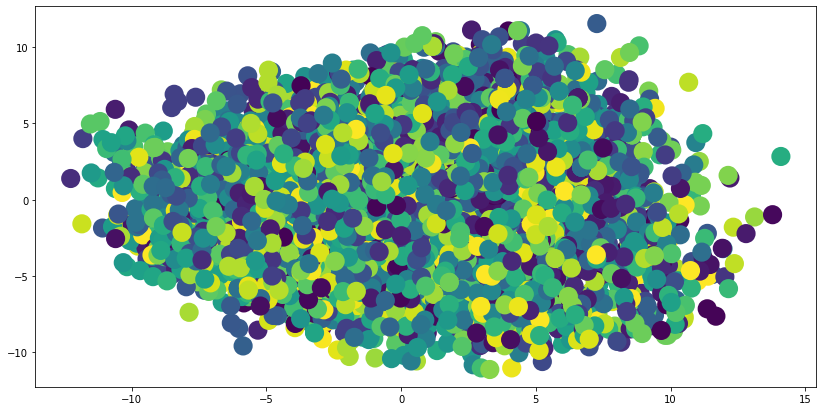

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_2  , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_2 , metric='euclidean'))


calinski harabasz score of model on train data:  1.9269263696869856
silhouette score of model on train data:  -0.6894469323142789


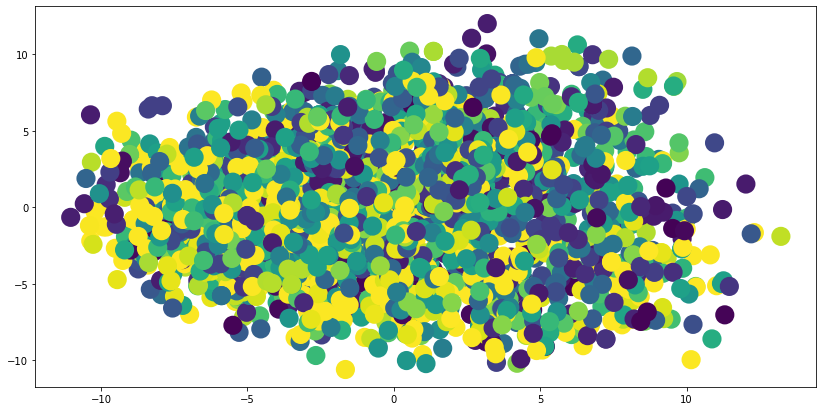

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_200_all_mini_l6v2_random_init.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_2, f)

In [ ]:
gmm_all_mini_l6v2_3 = GaussianMixture(n_components=500, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_3 = gmm_all_mini_l6v2_3.predict(principalComponents_all_mini_l6v2)
labels_3 = gmm_all_mini_l6v2_3.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_3, metric='euclidean'))


calinski harabasz score of model on train data:  3078.27363242097
silhouette score of model on train data:  0.2266771946515761


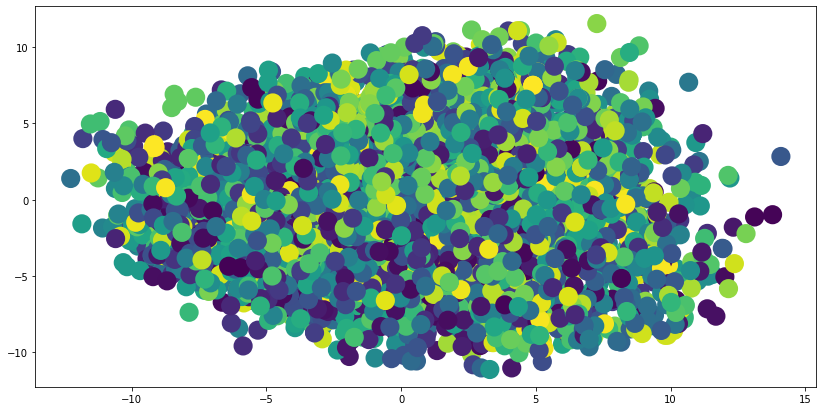

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_3 , metric='euclidean'))


calinski harabasz score of model on train data:  96.8863998661696
silhouette score of model on train data:  0.015294428062189664


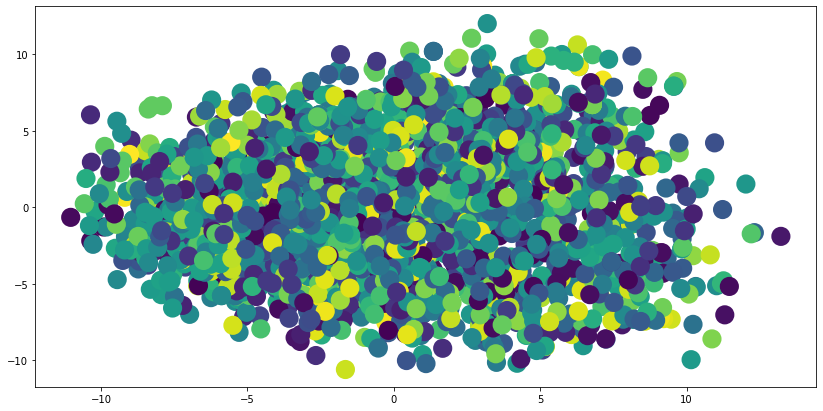

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_500_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_3, f)

In [ ]:
gmm_all_mini_l6v2_4 = GaussianMixture(n_components=350, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_4 = gmm_all_mini_l6v2_4.predict(principalComponents_all_mini_l6v2)
labels_4 = gmm_all_mini_l6v2_4.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_4, metric='euclidean'))


calinski harabasz score of model on train data:  3702.7341917548915
silhouette score of model on train data:  0.24767279343169682


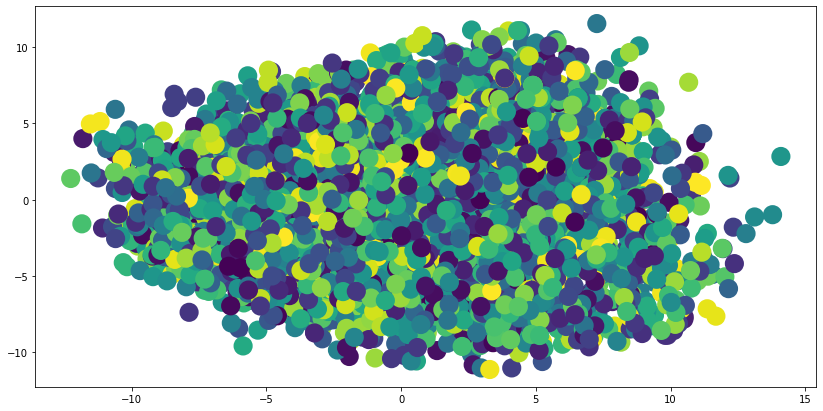

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_4 , metric='euclidean'))


calinski harabasz score of model on train data:  108.82199971201841
silhouette score of model on train data:  0.0004826149700110723


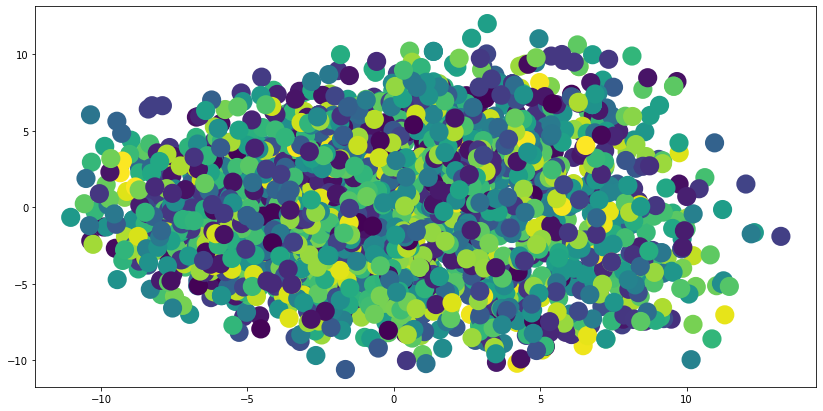

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_350_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_4, f)

In [ ]:
gmm_all_mini_l6v2_5 = GaussianMixture(n_components=400, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_5 = gmm_all_mini_l6v2_5.predict(principalComponents_all_mini_l6v2)
labels_5 = gmm_all_mini_l6v2_5.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_5, metric='euclidean'))


calinski harabasz score of model on train data:  3463.3102482977097
silhouette score of model on train data:  0.23933712560031783


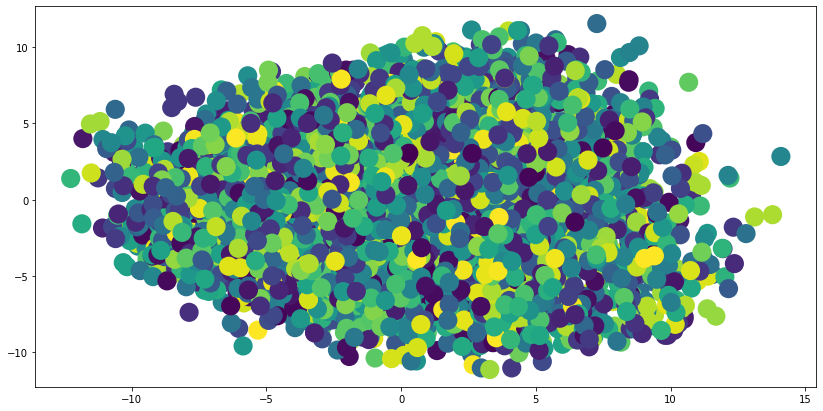

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_5 , metric='euclidean'))


calinski harabasz score of model on train data:  102.99099863130493
silhouette score of model on train data:  0.0008016746070209911


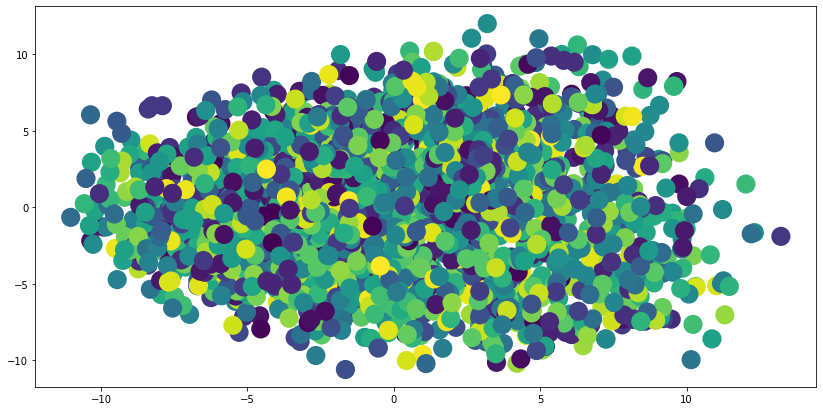

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_400_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_5, f)

In [ ]:
gmm_all_mini_l6v2_6 = GaussianMixture(n_components=150, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_6 = gmm_all_mini_l6v2_6.predict(principalComponents_all_mini_l6v2)
labels_6 = gmm_all_mini_l6v2_6.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_6, metric='euclidean'))


calinski harabasz score of model on train data:  4962.012014396835
silhouette score of model on train data:  0.2994751044839962


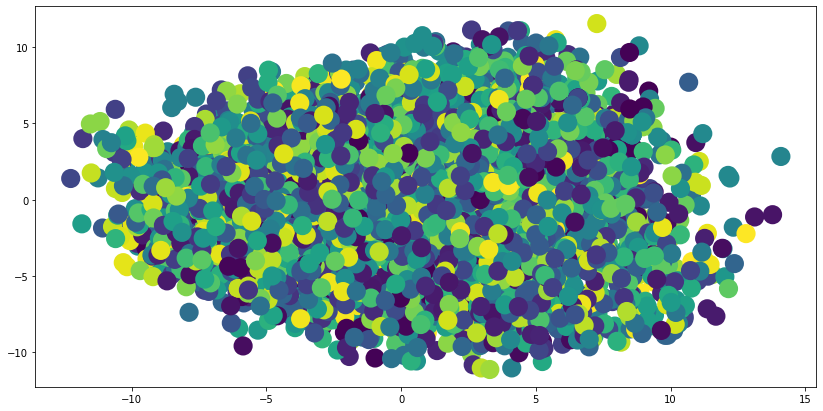

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_6 , metric='euclidean'))


calinski harabasz score of model on train data:  152.0089908339743
silhouette score of model on train data:  -0.09677487436421561


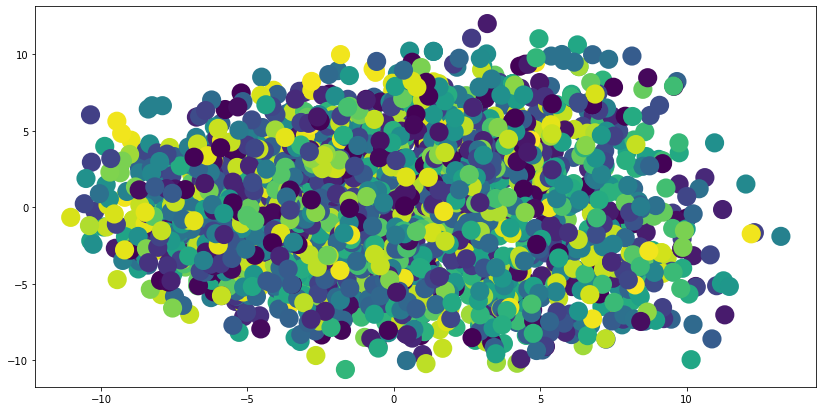

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_6, f)

In [ ]:
gmm_all_mini_l6v2_7 = GaussianMixture(n_components=100, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_7 = gmm_all_mini_l6v2_7.predict(principalComponents_all_mini_l6v2)
labels_7 = gmm_all_mini_l6v2_7.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_7, metric='euclidean'))


calinski harabasz score of model on train data:  5310.301228017125
silhouette score of model on train data:  0.3052492730804921


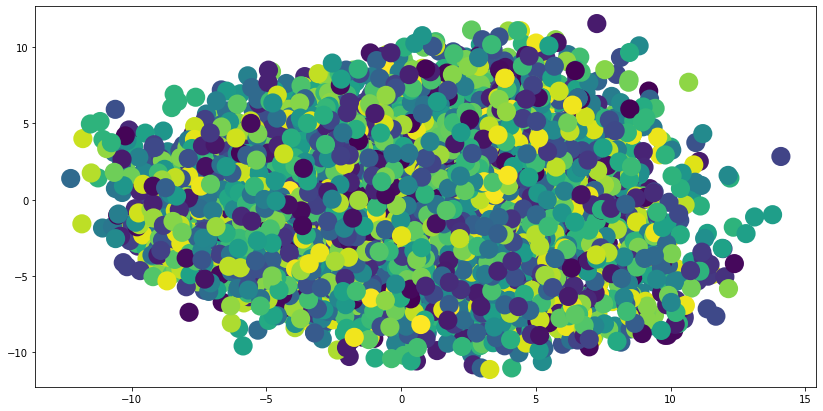

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_7 , metric='euclidean'))


calinski harabasz score of model on train data:  171.17113016947508
silhouette score of model on train data:  -0.15060001904932444


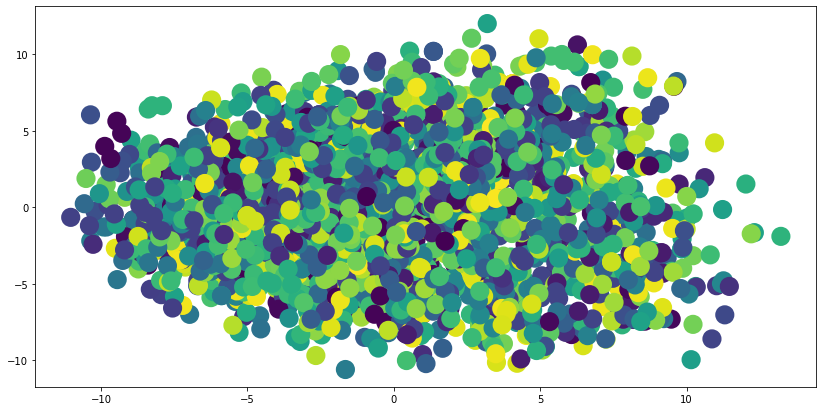

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_100_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_7, f)

In [ ]:
gmm_all_mini_l6v2_8 = GaussianMixture(n_components=50, covariance_type='full', random_state=0).fit(principalComponents_all_mini_l6v2)
fitted_8 = gmm_all_mini_l6v2_8.predict(principalComponents_all_mini_l6v2)
labels_8 = gmm_all_mini_l6v2_8.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_8 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_8, metric='euclidean'))


calinski harabasz score of model on train data:  5109.234513272792
silhouette score of model on train data:  0.33156120300377373


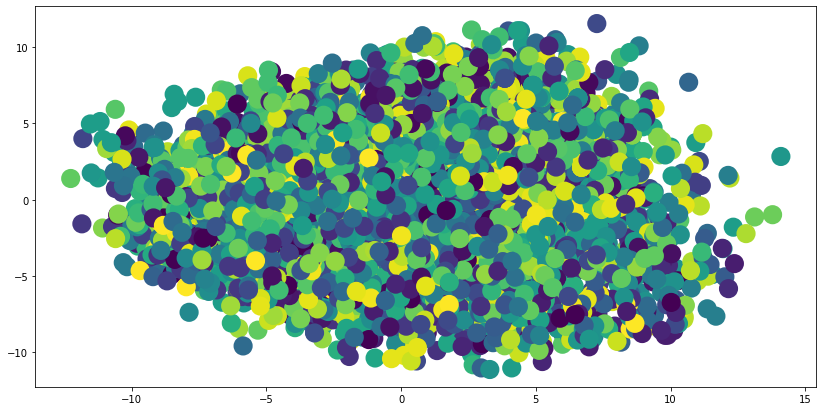

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_8 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_8 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_8 , metric='euclidean'))


calinski harabasz score of model on train data:  218.63627989319795
silhouette score of model on train data:  -0.23282073651858035


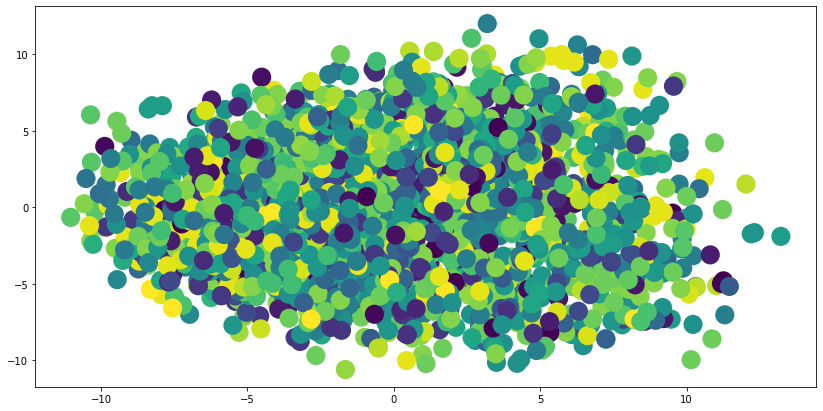

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_8 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_50_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_8, f)

In [ ]:
gmm_all_mini_l6v2_9 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000).fit(principalComponents_all_mini_l6v2)
fitted_9 = gmm_all_mini_l6v2_9.predict(principalComponents_all_mini_l6v2)
labels_9 = gmm_all_mini_l6v2_9.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_9 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_9, metric='euclidean'))


calinski harabasz score of model on train data:  4982.179965916195
silhouette score of model on train data:  0.2998682563009673


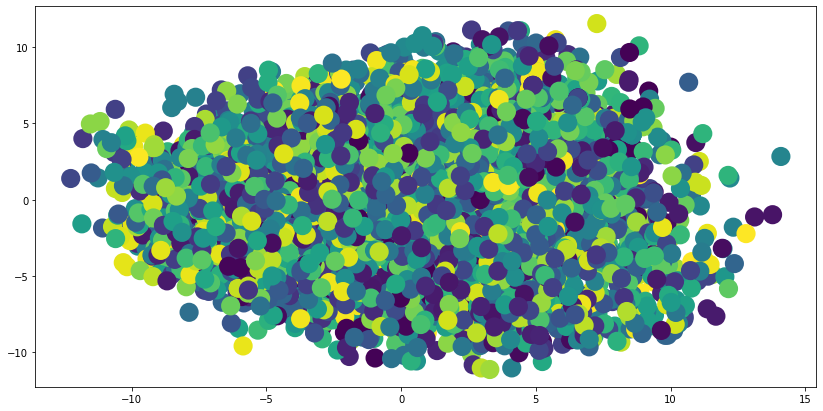

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_9 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_9 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_9 , metric='euclidean'))


calinski harabasz score of model on train data:  2150.5860280979523
silhouette score of model on train data:  0.2883483809317585


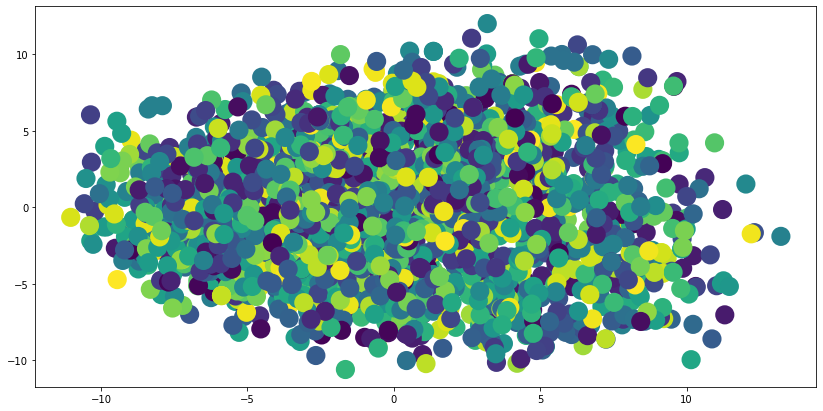

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_9 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mini_l6v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_9, f)

In [ ]:
gmm_all_mini_l6v2_10 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='k-means++').fit(principalComponents_all_mini_l6v2)
fitted_10 = gmm_all_mini_l6v2_10.predict(principalComponents_all_mini_l6v2)
labels_10 = gmm_all_mini_l6v2_10.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_10 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_10, metric='euclidean'))


calinski harabasz score of model on train data:  4869.342164103144
silhouette score of model on train data:  0.29333016964324965


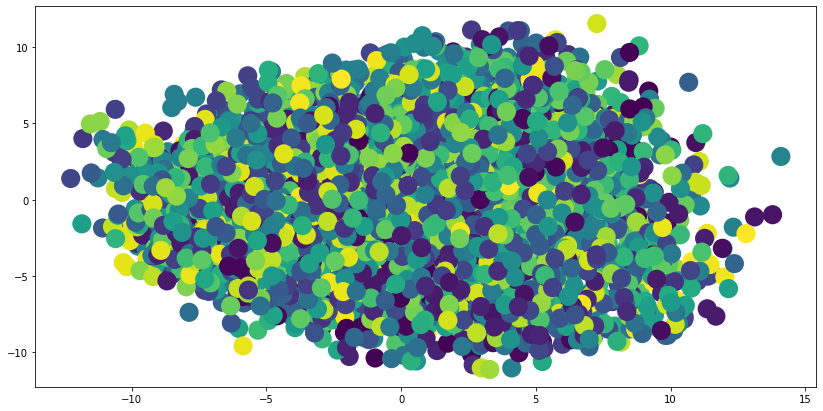

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_10 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_10 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_10 , metric='euclidean'))


calinski harabasz score of model on train data:  2090.9162434583213
silhouette score of model on train data:  0.28002246975237544


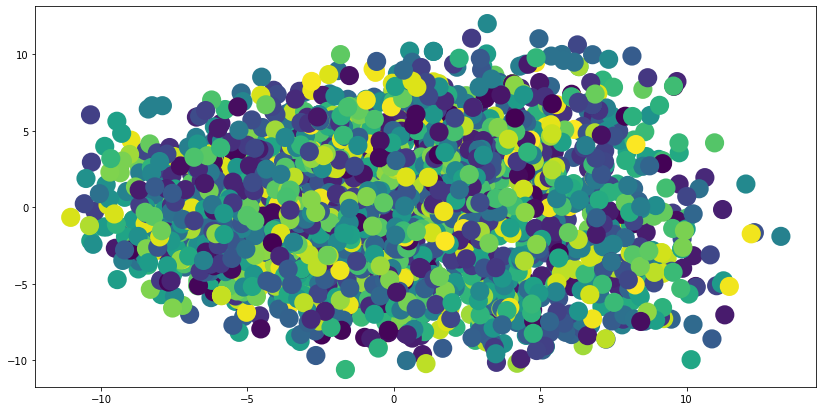

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_10 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mini_l6v2_kmeans++.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_10, f)

In [ ]:
gmm_all_mini_l6v2_11 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='random_from_data').fit(principalComponents_all_mini_l6v2)
fitted_11 = gmm_all_mini_l6v2_11.predict(principalComponents_all_mini_l6v2)
labels_11 = gmm_all_mini_l6v2_11.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_11 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_11, metric='euclidean'))


calinski harabasz score of model on train data:  4453.563457074989
silhouette score of model on train data:  0.28333479478342133


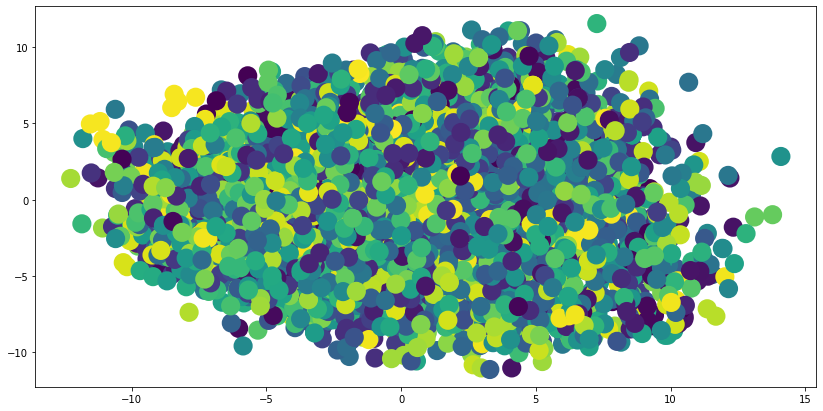

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_11 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_11 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_11 , metric='euclidean'))


calinski harabasz score of model on train data:  1878.3018811552533
silhouette score of model on train data:  0.27023578451305763


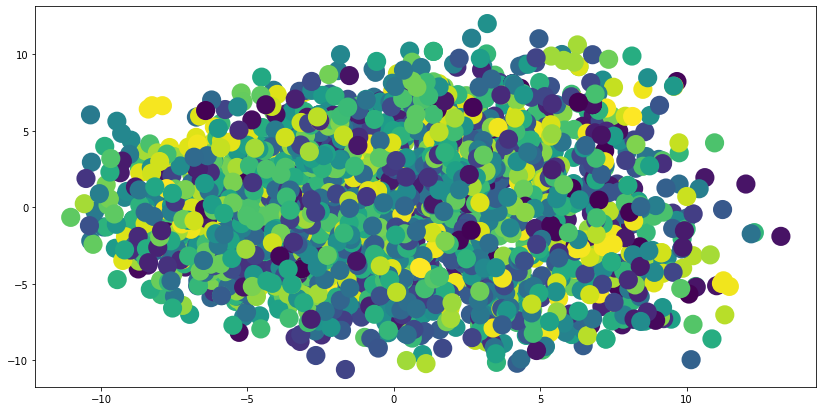

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_11 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mini_l6v2_random_from_data.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_11, f)

In [ ]:
gmm_all_mini_l6v2_12 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='random').fit(principalComponents_all_mini_l6v2)
fitted_12 = gmm_all_mini_l6v2_12.predict(principalComponents_all_mini_l6v2)
labels_12 = gmm_all_mini_l6v2_12.predict(principalComponents_all_mini_l6v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2,fitted_12 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2, fitted_12, metric='euclidean'))


calinski harabasz score of model on train data:  3372.585844133019
silhouette score of model on train data:  0.25885007849472635


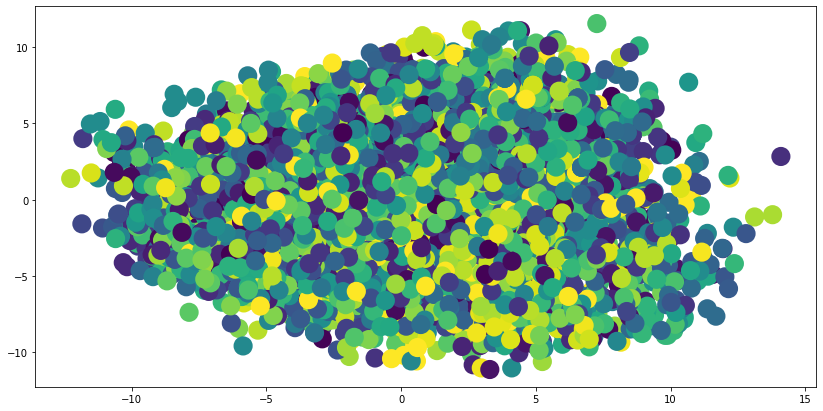

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2.iloc[:, 0], principalComponents_all_mini_l6v2.iloc[:, 1], c=fitted_12 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mini_l6v2_test,labels_12 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mini_l6v2_test, labels_12 , metric='euclidean'))


calinski harabasz score of model on train data:  1615.3172944861542
silhouette score of model on train data:  0.26631612331929344


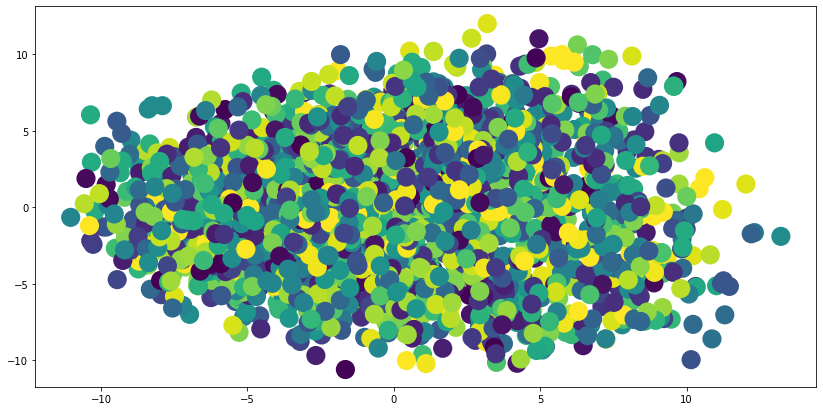

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mini_l6v2_test.iloc[:, 0], principalComponents_all_mini_l6v2_test.iloc[:, 1], c=labels_12 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mini_l6v2_random.pickle', 'wb') as f:
    pickle.dump(gmm_all_mini_l6v2_12, f)

### Model : all-mpnet-base-v2

In [ ]:
gmm_all_mpnet_basev2 = GaussianMixture(n_components=200, covariance_type='full', random_state=0).fit(principalComponents_all_mpnet_basev2)
fitted = gmm_all_mpnet_basev2.predict(principalComponents_all_mpnet_basev2)
labels = gmm_all_mpnet_basev2.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2, fitted ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted , metric='euclidean'))


calinski harabasz score of model on train data:  3230.3378487844425
silhouette score of model on train data:  0.23065696214560338


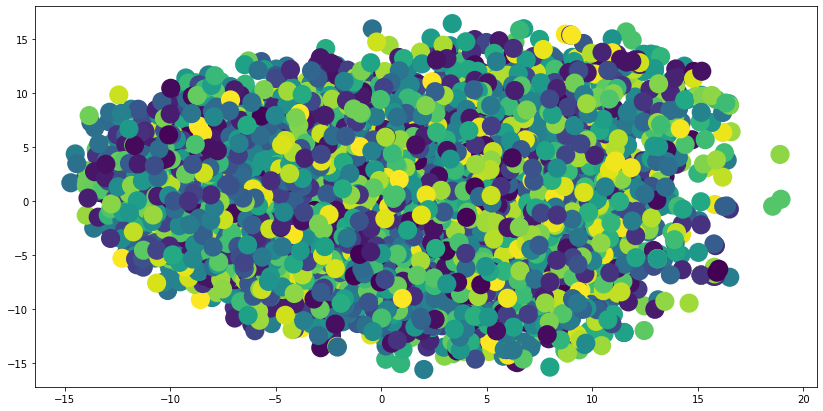

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels , metric='euclidean'))


calinski harabasz score of model on train data:  169.19311148497712
silhouette score of model on train data:  -0.014097596169848223


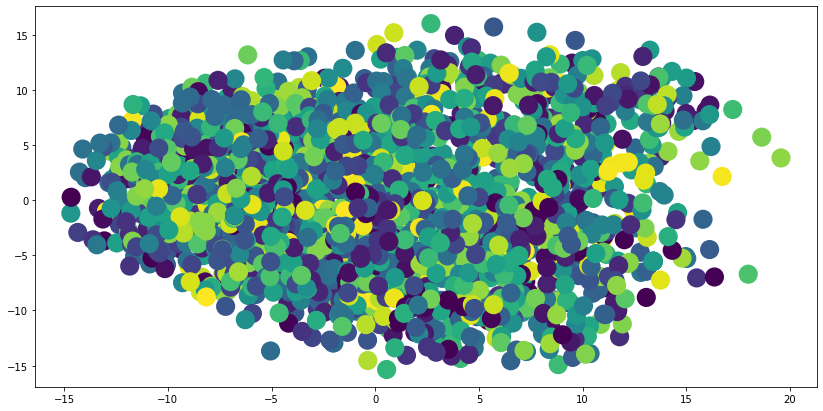

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_200_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2, f)

In [ ]:
gmm_all_mpnet_basev2_2 = GaussianMixture(n_components=200, covariance_type='full', random_state=0, init_params='random').fit(principalComponents_all_mpnet_basev2)
fitted_2 = gmm_all_mpnet_basev2_2.predict(principalComponents_all_mpnet_basev2)
labels_2 = gmm_all_mpnet_basev2_2.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,fitted_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_2  , metric='euclidean'))


calinski harabasz score of model on train data:  1.8400576046316603
silhouette score of model on train data:  -0.30581092803742094


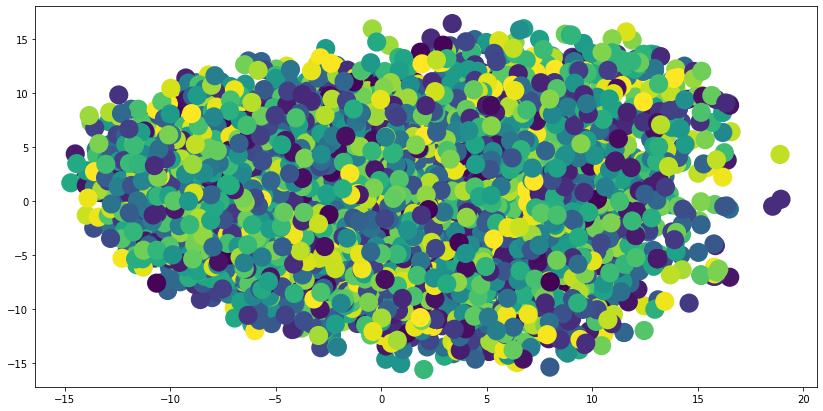

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_2  , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_2 , metric='euclidean'))


calinski harabasz score of model on train data:  1.8225360608178054
silhouette score of model on train data:  -0.6669364438814557


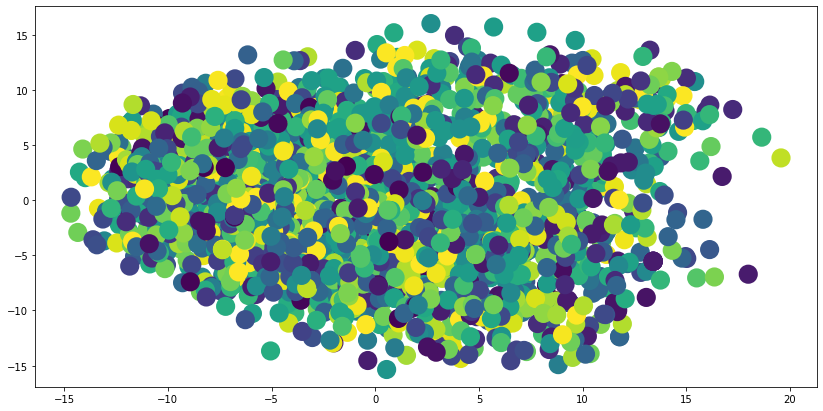

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_200_all_mpnet_basev2_random_init.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_2, f)

In [ ]:
#k-means elbow gives 1001 for clusters
gmm_all_mpnet_basev2_3 = GaussianMixture(n_components=350, covariance_type='full', random_state=0).fit(principalComponents_all_mpnet_basev2)
fitted_3 = gmm_all_mpnet_basev2_3.predict(principalComponents_all_mpnet_basev2)
#labels_3 = gmm_all_mpnet_basev2_3.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,fitted_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_3, metric='euclidean'))


calinski harabasz score of model on train data:  2325.130755215375
silhouette score of model on train data:  0.19477949865270164


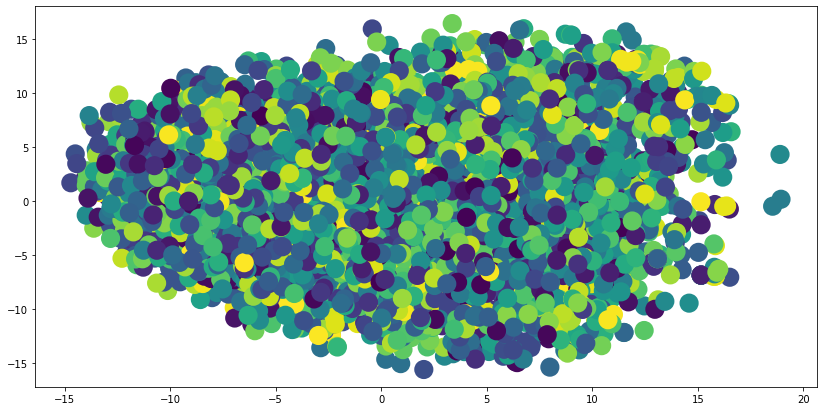

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_3 , metric='euclidean'))


calinski harabasz score of model on train data:  92.79043776928401
silhouette score of model on train data:  -0.004682765373122847


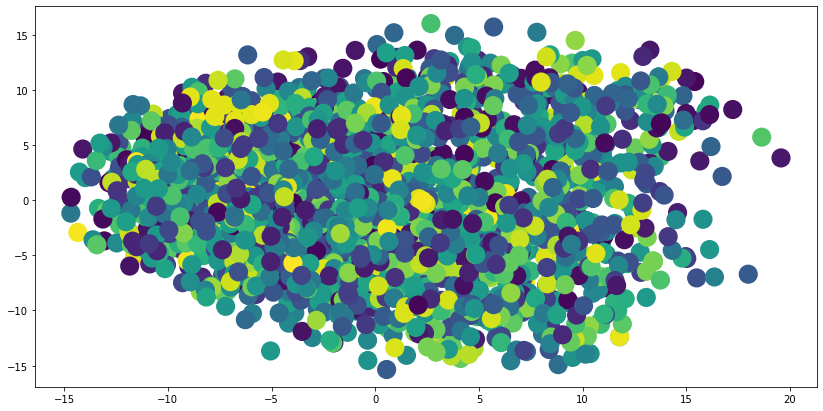

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_350_all_mpnet_basev2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_3, f)

In [ ]:
gmm_all_mpnet_basev2_4 = GaussianMixture(n_components=150, covariance_type='full', random_state=0).fit(principalComponents_all_mpnet_basev2)
fitted_4 = gmm_all_mpnet_basev2_4.predict(principalComponents_all_mpnet_basev2)
labels_4 = gmm_all_mpnet_basev2_4.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2,fitted_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_4 , metric='euclidean'))


calinski harabasz score of model on train data:  3644.8115697666735
silhouette score of model on train data:  0.24397035094511543


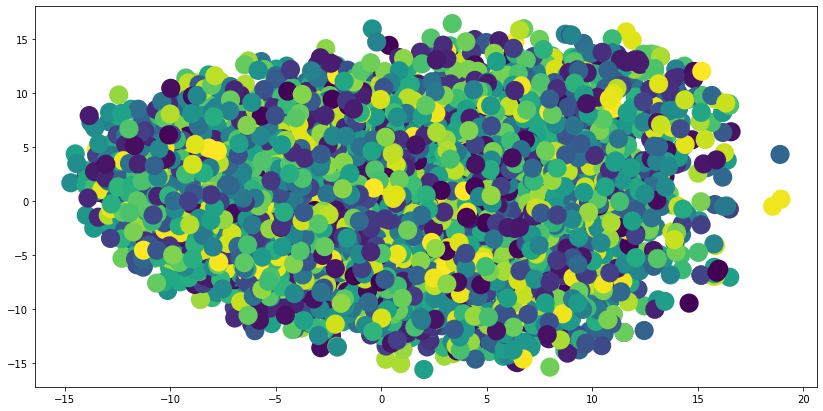

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_4 , metric='euclidean'))


calinski harabasz score of model on train data:  172.4266871123721
silhouette score of model on train data:  -0.06652612107835072


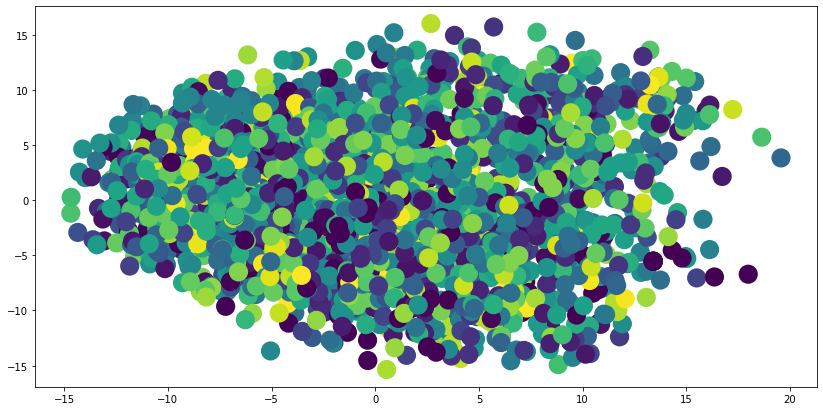

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_4, f)

In [ ]:
gmm_all_mpnet_basev2_5 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000).fit(principalComponents_all_mpnet_basev2)
fitted_5 = gmm_all_mpnet_basev2_5.predict(principalComponents_all_mpnet_basev2)
labels_5 = gmm_all_mpnet_basev2_5.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2, fitted_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_5 , metric='euclidean'))


calinski harabasz score of model on train data:  3644.8075210393854
silhouette score of model on train data:  0.24336731236087958


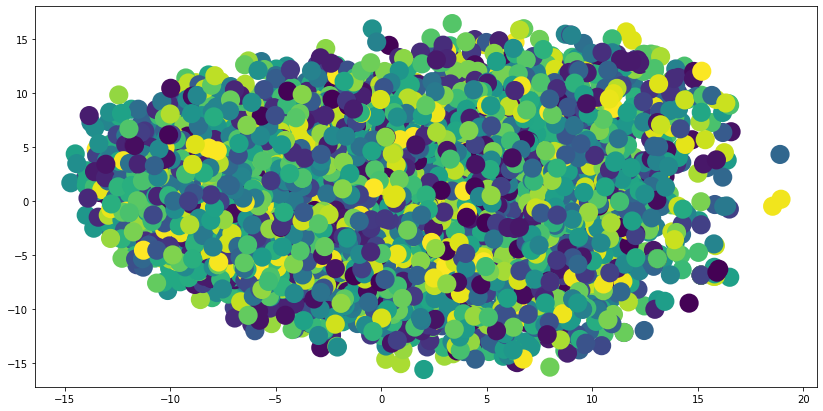

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_5 , metric='euclidean'))


calinski harabasz score of model on train data:  1576.922919581979
silhouette score of model on train data:  0.23265940785878628


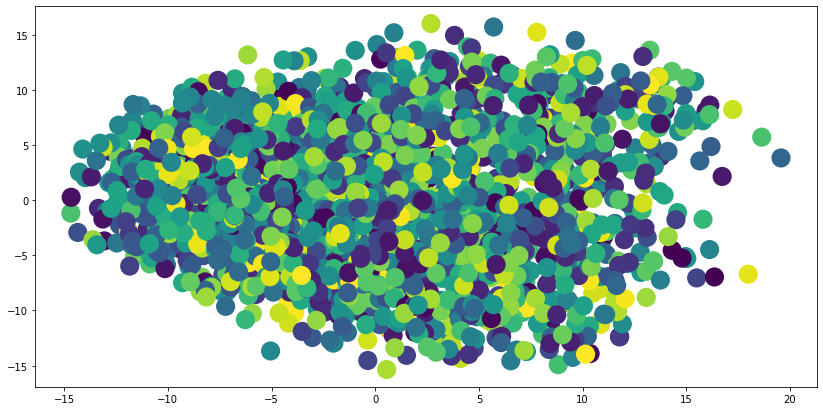

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mpnet_basev2.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_5, f)

In [ ]:
gmm_all_mpnet_basev2_6 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='k-means++').fit(principalComponents_all_mpnet_basev2)
fitted_6 = gmm_all_mpnet_basev2_6.predict(principalComponents_all_mpnet_basev2)
labels_6 = gmm_all_mpnet_basev2_6.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2, fitted_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_6 , metric='euclidean'))


calinski harabasz score of model on train data:  3633.6400158955184
silhouette score of model on train data:  0.2424030213641726


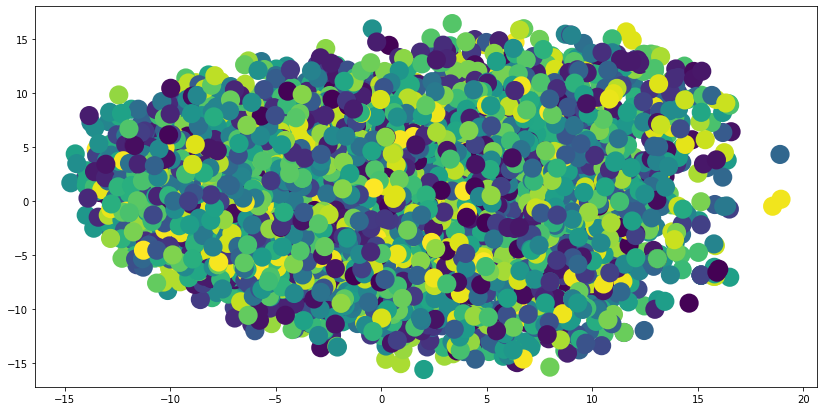

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_6 , metric='euclidean'))


calinski harabasz score of model on train data:  1563.600035419692
silhouette score of model on train data:  0.2294254079814283


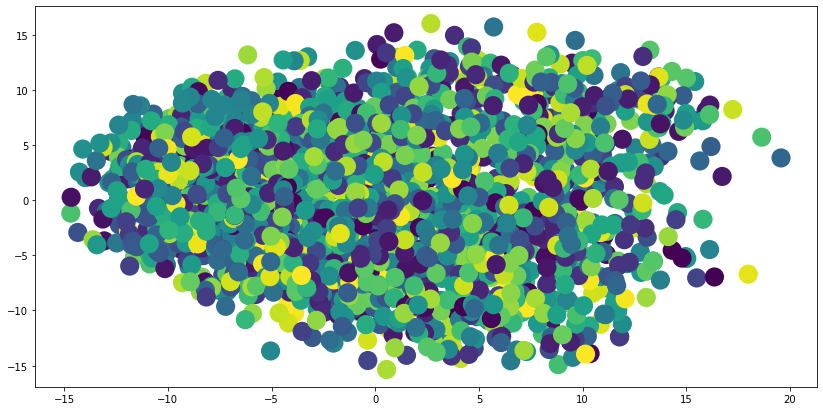

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mpnet_basev2_kmeans++.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_6, f)

In [ ]:
gmm_all_mpnet_basev2_7 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='random_from_data').fit(principalComponents_all_mpnet_basev2)
fitted_7 = gmm_all_mpnet_basev2_7.predict(principalComponents_all_mpnet_basev2)
labels_7 = gmm_all_mpnet_basev2_7.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2, fitted_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_7 , metric='euclidean'))


calinski harabasz score of model on train data:  3377.7058483402166
silhouette score of model on train data:  0.23117107978250165


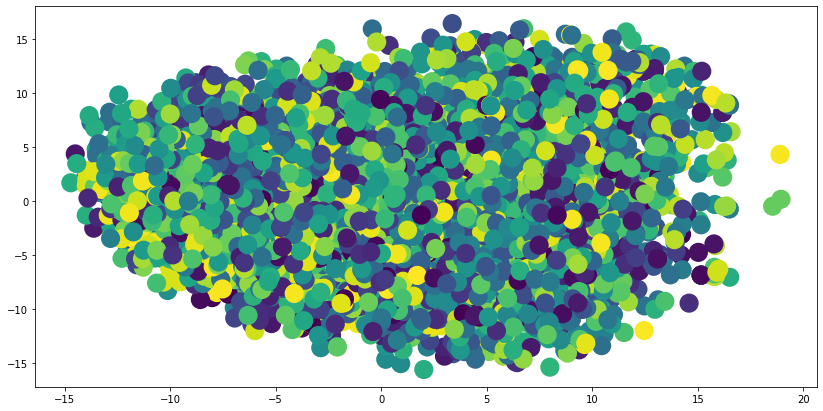

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_7 , metric='euclidean'))


calinski harabasz score of model on train data:  1436.570171356313
silhouette score of model on train data:  0.2201320464749606


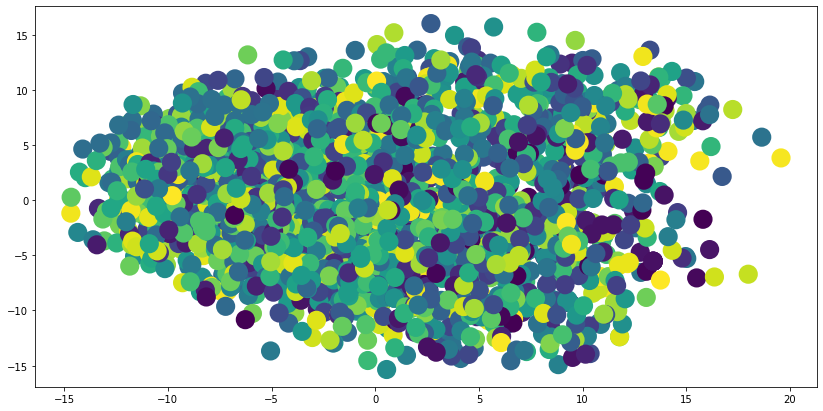

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mpnet_basev2_random_from_data.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_7, f)

In [ ]:
gmm_all_mpnet_basev2_8 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000, init_params='random').fit(principalComponents_all_mpnet_basev2)
fitted_8 = gmm_all_mpnet_basev2_8.predict(principalComponents_all_mpnet_basev2)
labels_8 = gmm_all_mpnet_basev2_8.predict(principalComponents_all_mpnet_basev2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2, fitted_8 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2, fitted_8 , metric='euclidean'))


calinski harabasz score of model on train data:  2886.54144925169
silhouette score of model on train data:  0.23262598770742404


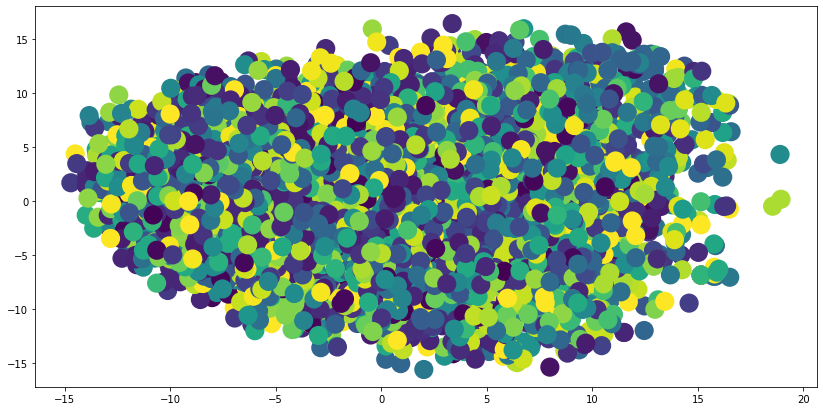

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2.iloc[:, 0], principalComponents_all_mpnet_basev2.iloc[:, 1], c=fitted_8 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_mpnet_basev2_test,labels_8 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_mpnet_basev2_test, labels_8 , metric='euclidean'))


calinski harabasz score of model on train data:  1428.4587123613308
silhouette score of model on train data:  0.25384221407934104


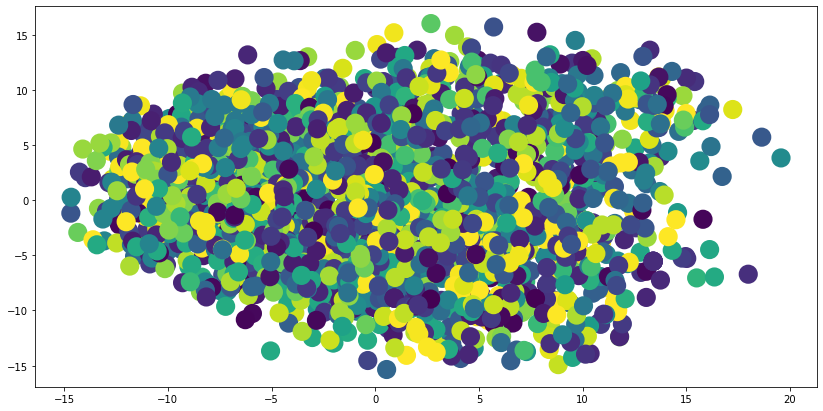

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_mpnet_basev2_test.iloc[:, 0], principalComponents_all_mpnet_basev2_test.iloc[:, 1], c=labels_8 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_mpnet_basev2_random.pickle', 'wb') as f:
    pickle.dump(gmm_all_mpnet_basev2_8, f)

### Model : paraphrase-MiniLM-L3-v2

In [ ]:
gmm_all_minilm_l3v2 = GaussianMixture(n_components=200, covariance_type='full', random_state=0).fit(principalComponents_all_minilm_l3v2)
fitted = gmm_all_minilm_l3v2.predict(principalComponents_all_minilm_l3v2)
labels = gmm_all_minilm_l3v2.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2, fitted ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted , metric='euclidean'))


calinski harabasz score of model on train data:  1459.309289260911
silhouette score of model on train data:  0.23977295602380067


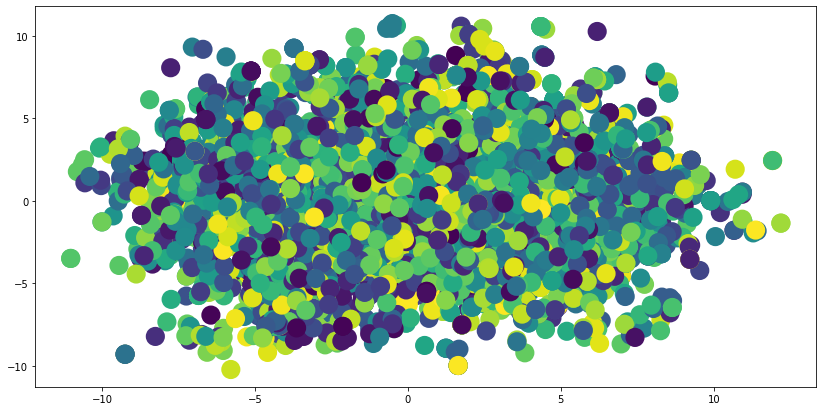

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels , metric='euclidean'))


calinski harabasz score of model on train data:  58.06282099256786
silhouette score of model on train data:  -0.41567359587683594


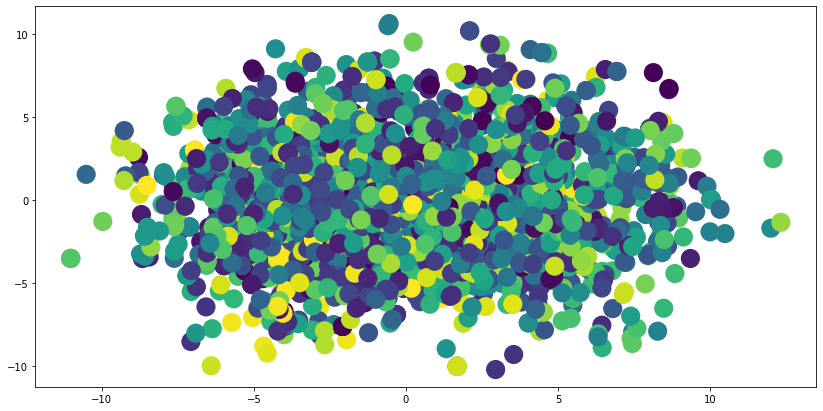

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_200_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2, f)

In [ ]:
gmm_all_minilm_l3v2_2 = GaussianMixture(n_components=350, covariance_type='full', random_state=0).fit(principalComponents_all_minilm_l3v2)
fitted_2 = gmm_all_minilm_l3v2_2.predict(principalComponents_all_minilm_l3v2)
labels_2 = gmm_all_minilm_l3v2_2.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_2  , metric='euclidean'))


calinski harabasz score of model on train data:  2430.4511343172358
silhouette score of model on train data:  0.23107667844622576


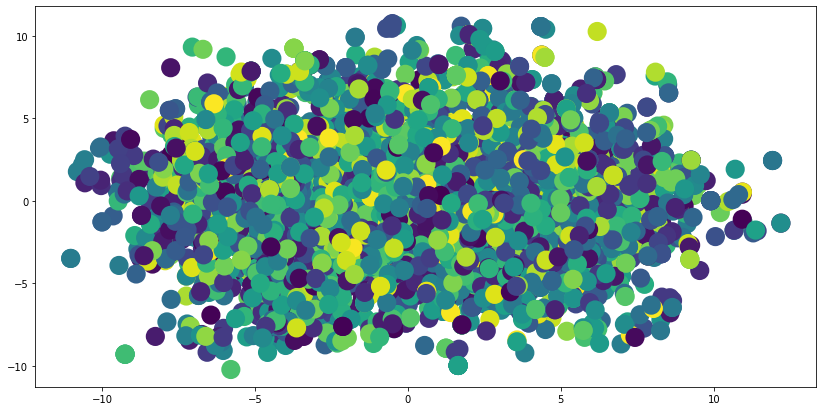

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_2  , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_2 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_2 , metric='euclidean'))


calinski harabasz score of model on train data:  39.98549402644421
silhouette score of model on train data:  -0.36775580122083157


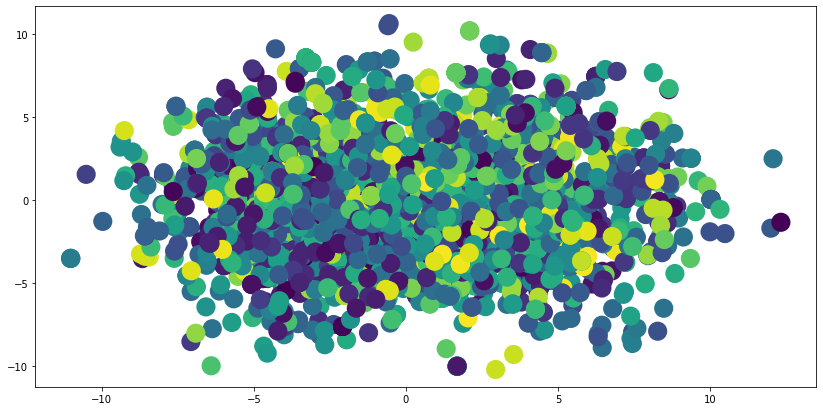

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_2 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_350_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_2, f)

In [ ]:
gmm_all_minilm_l3v2_3 = GaussianMixture(n_components=150, covariance_type='full', random_state=0).fit(principalComponents_all_minilm_l3v2)
fitted_3 = gmm_all_minilm_l3v2_3.predict(principalComponents_all_minilm_l3v2)
labels_3 = gmm_all_minilm_l3v2_3.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_3, metric='euclidean'))


calinski harabasz score of model on train data:  1593.498159912586
silhouette score of model on train data:  0.21036100220470882


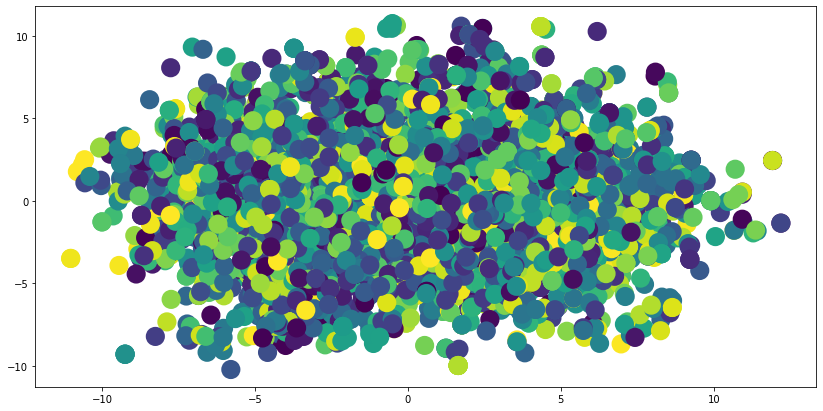

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_3 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_3 , metric='euclidean'))


calinski harabasz score of model on train data:  68.95548045857376
silhouette score of model on train data:  -0.4397738288463197


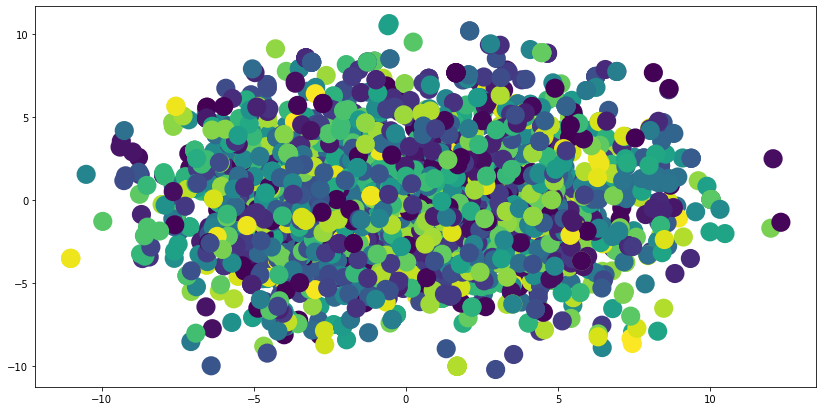

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_3 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_all_minilm_l3v2_.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_3, f)

In [ ]:
gmm_all_minilm_l3v2_4 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, max_iter=1000).fit(principalComponents_all_minilm_l3v2)
fitted_4 = gmm_all_minilm_l3v2_4.predict(principalComponents_all_minilm_l3v2)
labels_4 = gmm_all_minilm_l3v2_4.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_4 , metric='euclidean'))


calinski harabasz score of model on train data:  4895.3254855748
silhouette score of model on train data:  0.2939633614564003


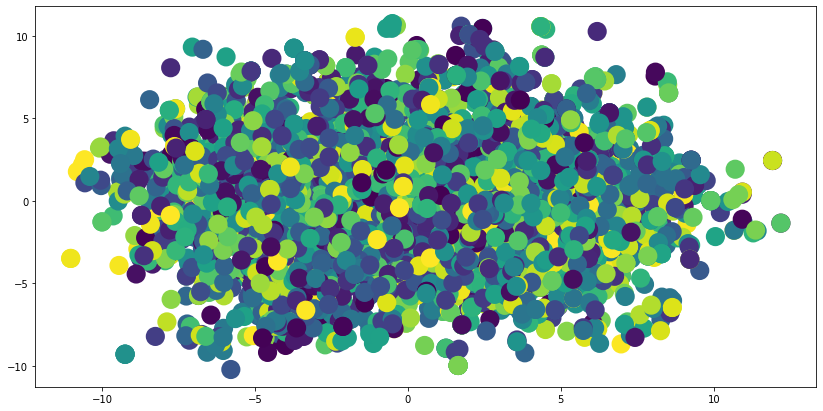

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_4 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_4 , metric='euclidean'))


calinski harabasz score of model on train data:  2073.047273147617
silhouette score of model on train data:  0.278095546929657


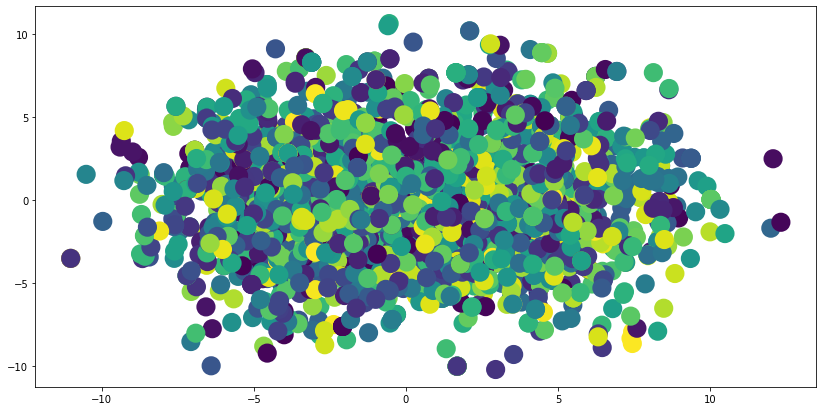

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_4 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_minilm_l3v2.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_4, f)

In [ ]:
gmm_all_minilm_l3v2_5 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, init_params="random_from_data", max_iter=1000).fit(principalComponents_all_minilm_l3v2)
fitted_5 = gmm_all_minilm_l3v2_5.predict(principalComponents_all_minilm_l3v2)
labels_5 = gmm_all_minilm_l3v2_5.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_5 , metric='euclidean'))


calinski harabasz score of model on train data:  4376.2113415706835
silhouette score of model on train data:  0.27507911578398025


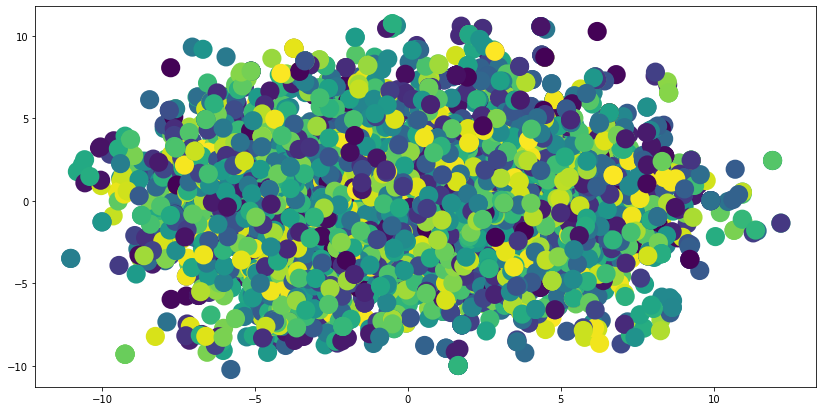

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_5 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_5 , metric='euclidean'))


calinski harabasz score of model on train data:  1859.916883354434
silhouette score of model on train data:  0.2645406749702636


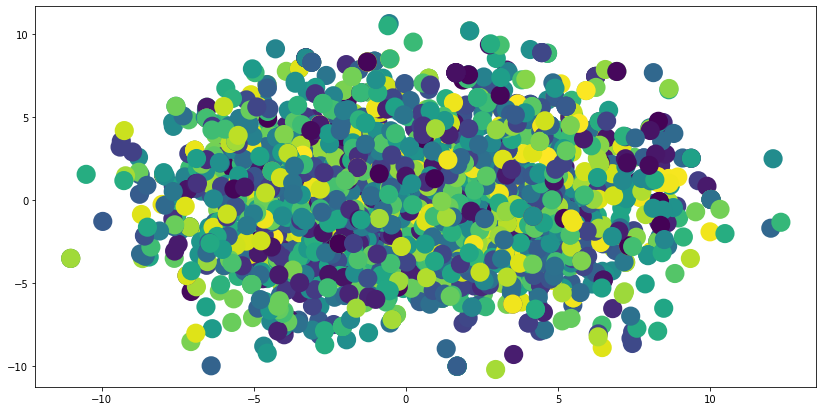

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_5 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_all_minilm_l3v2_random_from_data.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_5, f)

In [ ]:
gmm_all_minilm_l3v2_6 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, init_params="k-means++", max_iter=1000).fit(principalComponents_all_minilm_l3v2)
fitted_6 = gmm_all_minilm_l3v2_6.predict(principalComponents_all_minilm_l3v2)
labels_6= gmm_all_minilm_l3v2_6.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_6 , metric='euclidean'))


calinski harabasz score of model on train data:  4798.181593544533
silhouette score of model on train data:  0.2869626326320826


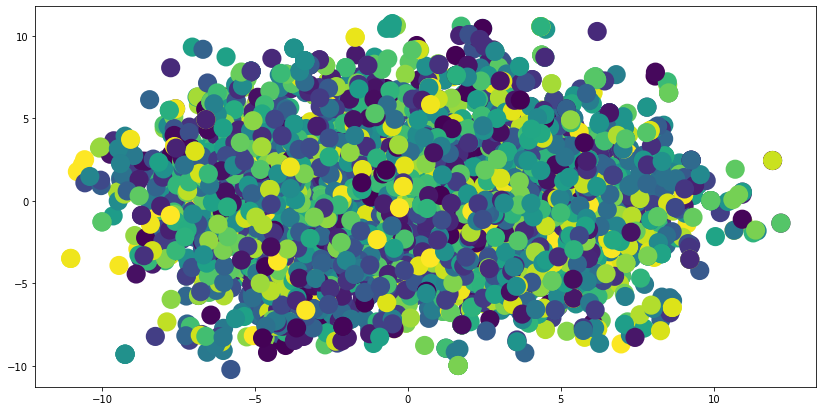

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_6 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_6 , metric='euclidean'))


calinski harabasz score of model on train data:  2045.7057484966476
silhouette score of model on train data:  0.2747697494874693


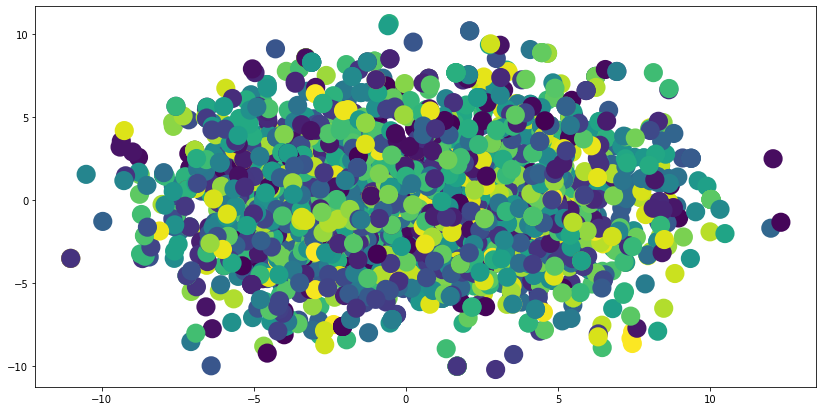

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_6 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_minilm_l3v2_kmeans++.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_6, f)

In [ ]:
gmm_all_minilm_l3v2_7 = GaussianMixture(n_components=150, covariance_type='spherical', random_state=0, init_params="random", max_iter=1000).fit(principalComponents_all_minilm_l3v2)
fitted_7 = gmm_all_minilm_l3v2_7.predict(principalComponents_all_minilm_l3v2)
labels_7 = gmm_all_minilm_l3v2_7.predict(principalComponents_all_minilm_l3v2_test)
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2,fitted_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2, fitted_7 , metric='euclidean'))


calinski harabasz score of model on train data:  3115.2179410652866
silhouette score of model on train data:  0.24255104771715835


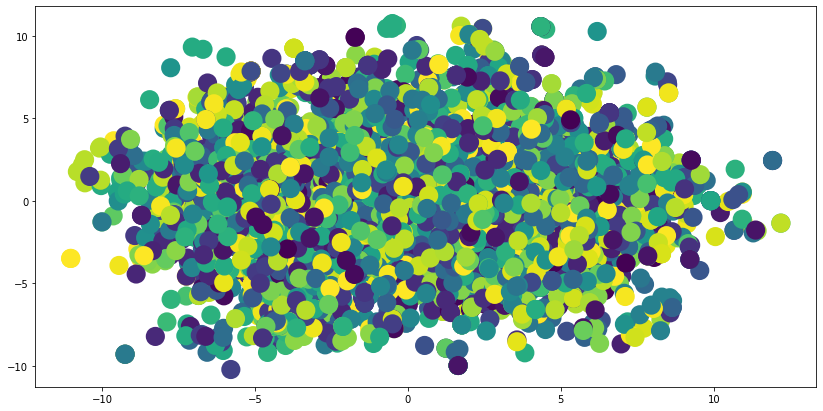

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2.iloc[:, 0], principalComponents_all_minilm_l3v2.iloc[:, 1], c=fitted_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
print("calinski harabasz score of model on train data: ", metrics.calinski_harabasz_score(principalComponents_all_minilm_l3v2_test,labels_7 ))
print("silhouette score of model on train data: " , metrics.silhouette_score(principalComponents_all_minilm_l3v2_test, labels_7 , metric='euclidean'))


calinski harabasz score of model on train data:  1518.3525303098081
silhouette score of model on train data:  0.26283831414117714


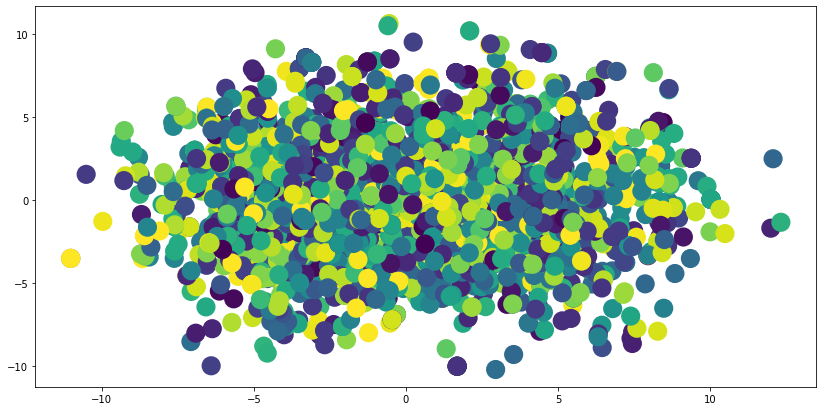

In [ ]:
plt.figure(figsize=(14, 7))
plt.scatter(principalComponents_all_minilm_l3v2_test.iloc[:, 0], principalComponents_all_minilm_l3v2_test.iloc[:, 1], c=labels_7 , s=200, cmap='viridis', linewidths=5)


In [ ]:
with open('gm_150_spherical_all_minilm_l3v2_random.pickle', 'wb') as f:
    pickle.dump(gmm_all_minilm_l3v2_7, f)

## Clustering Analysis

**Only for the most accurate clustering model you recommend**,

1.   How many clusters did the model you propose create?
2.   What is the number of papers in each cluster?
3.   What is the unique number of authors in each cluster?
4.   What are the top 3 most frequently used words (the words that describe the cluster) in each cluster?
        
        Ex: https://www.sbert.net/examples/applications/clustering/README.html


In [8]:
loaded_model = pickle.load(open("gm_150_spherical_all_mini_l6v2_.pickle", 'rb'))

In [11]:
#How many clusters did the model you propose create?
print("Number of cluster of the proposed model: ", len(loaded_model.weights_))

Number of cluster of the proposed model:  150


In [ ]:
train_predict = loaded_model.predict(principalComponents_all_mini_l6v2)
test_predict = loaded_model.predict(principalComponents_all_mini_l6v2_test)
train_predict = np.append(train_predict, test_predict)

In [109]:
#What is the unique number of authors in each cluster?
df = pd.DataFrame(df)
df_all_publications = pd.DataFrame(df_all_publications)
df_selected_author_publications["author_id"] =df_selected_author_publications["author"]
authors = pd.merge(df_all_authors, df_selected_author_publications, on="author_id", how="inner")


In [113]:
papers = pd.merge(df, df_all_publications, on="paper_title", how="inner")

In [166]:
papers["publication"] =papers["paper_id"]
all_authors_papers = pd.merge(papers, authors, on="publication", how="inner")

In [167]:
all_authors_papers["author_name"] = all_authors_papers["author_fname"] + all_authors_papers["author_lname"]
all_authors_papers= all_authors_papers[["paper_title", "author_name"]]
all_authors_papers.head()

,paper_title,author_name
0,Linked open data-based explanations for transp...,FedelucioNarducci
1,Linked open data-based explanations for transp...,FedelucioNarducci
2,Linked open data-based explanations for transp...,FedelucioNarducci
3,Moving from Item Rating to Features Relevance ...,TommasoNoia
4,Moving from Item Rating to Features Relevance ...,EugenioSciascio


In [168]:
df.head()

,paper_title,paper_abstract,paper_published_conference,cited_paper_title,cited_paper_published_conference,cited_paper_abstract,text,label
0,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,the effects of transparency on trust in and ac...,Internet Measurement Conference,"Traditionally, users have discovered informati...",Linked open data-based explanations for transp...,27
1,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,explaining collaborative filtering recommendat...,Interactive Decision Theory and Game Theory,"We develop a Bayesian approach, to concept lea...",Linked open data-based explanations for transp...,47
2,Linked open data-based explanations for transp...,In this article we propose a framework that ge...,Int. J. Hum.-Comput. Stud.,tagsplanations explaining recommendations usin...,ACM Trans. Economics and Comput.,The final step in getting an Israeli M.D. is p...,Linked open data-based explanations for transp...,70
3,Moving from Item Rating to Features Relevance ...,Although very effective in computing accurate ...,IIR,sparse linear methods with side information fo...,IEEE Trans. Pattern Anal. Mach. Intell.,The dynamic texture (DT) is a probabilistic ge...,Moving from Item Rating to Features Relevance ...,68
4,A Domain-independent Framework for building Co...,Conversational Recommender Systems (CoRSs) imp...,KaRS@RecSys,interacting with recommenders x02014 overview ...,AAAI,This work addresses the problem of efficiently...,A Domain-independent Framework for building Co...,30


In [169]:
df["label"] = train_predict

In [170]:
all_authors_papers = pd.merge(all_authors_papers, df, on="paper_title", how="inner")

In [159]:
all_authors_papers_grouped = all_authors_papers[["author_name", "label"]]

In [160]:
all_authors_papers_grouped = all_authors_papers_grouped.drop_duplicates(["author_name", "label"])

In [161]:
all_authors_papers_grouped.head()

,author_name,label
0,FedelucioNarducci,27
1,FedelucioNarducci,47
2,FedelucioNarducci,70
9,TommasoNoia,68
10,EugenioSciascio,68


In [162]:
all_authors_papers_grouped = all_authors_papers_grouped.groupby(['label']).size().reset_index(name='counts')

In [163]:
all_authors_papers_grouped

,label,counts
0,0,14
1,1,24
2,2,41
3,3,22
4,4,32
...,...,...
145,145,16
146,146,21
147,147,16
148,148,19


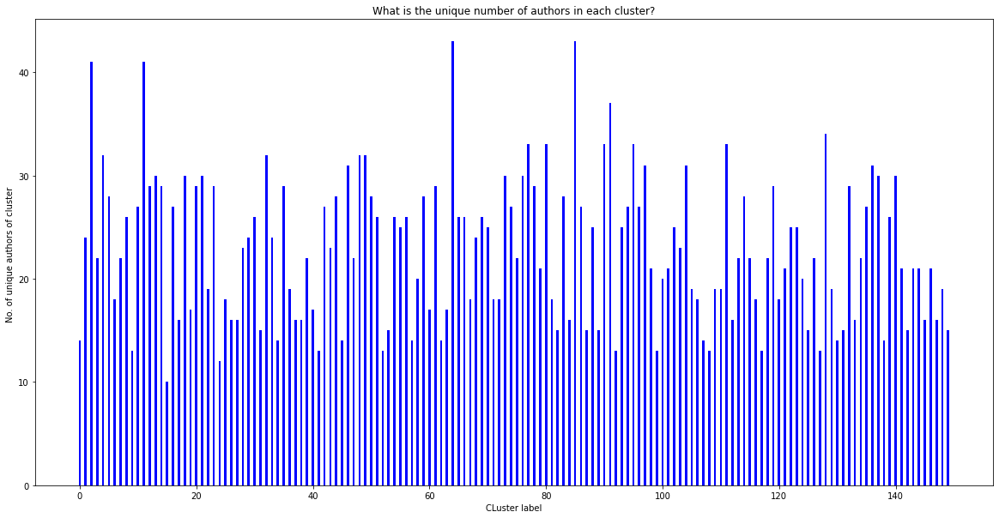

In [164]:
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize = (20, 10))
 
# creating the bar plot
plt.bar(all_authors_papers_grouped["label"], all_authors_papers_grouped["counts"], color ='blue',
        width = 0.4)
 
plt.xlabel("CLuster label")
plt.ylabel("No. of unique authors of cluster ")
plt.title("What is the unique number of authors in each cluster?")
plt.show()

In [172]:
#What is the number of papers in each cluster?
all_authors_papers_in_cluster = all_authors_papers[["paper_title", "label"]]
train_frequencie_list = all_authors_papers_in_cluster.groupby(['label']).size().reset_index(name='counts')

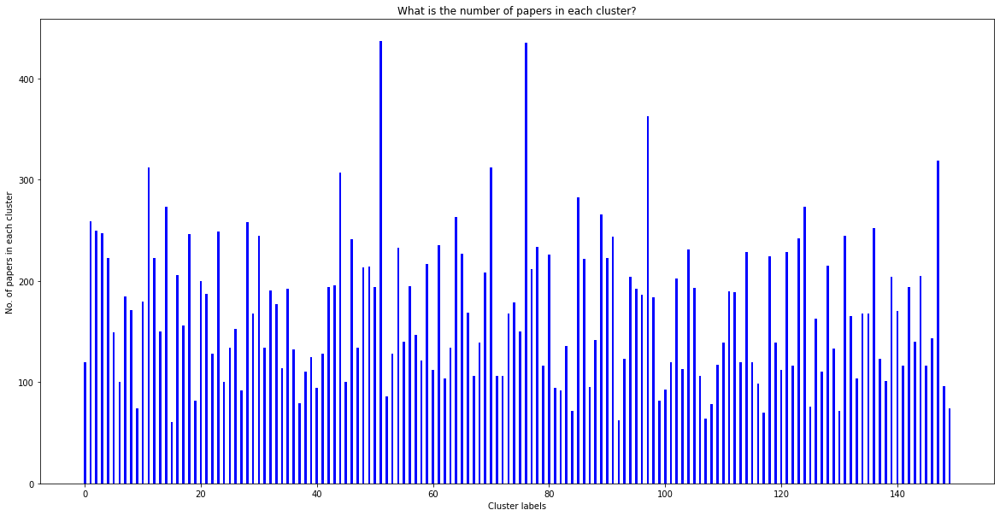

In [174]:
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize = (20, 10))
 
# creating the bar plot
plt.bar(train_frequencie_list["label"], train_frequencie_list["counts"], color ='blue',
        width = 0.4)
 
plt.xlabel("Cluster labels")
plt.ylabel("No. of papers in each cluster")
plt.title("What is the number of papers in each cluster?")
plt.show()

In [189]:
#What are the top 3 most frequently used words (the words that describe the cluster) in each cluster?
df["label"] = train_predict
clustered = df
clustered['text'] = df[['text','label']].groupby(['label'])['text'].transform(lambda x: ','.join(x))
clustered = clustered[['text','label']].drop_duplicates()

In [191]:
clustered.reset_index(drop=True, inplace=True)

In [222]:
from collections import Counter
topics= {}
for i in range(clustered["text"].count()):
  split = clustered["text"][i].split()
  cnt= Counter(split)
  most_occur = cnt.most_common(3)
  topics[i] = cnt
  

In [229]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors
cols = [color for name, color in mcolors.XKCD_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=STOPWORDS,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=3,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

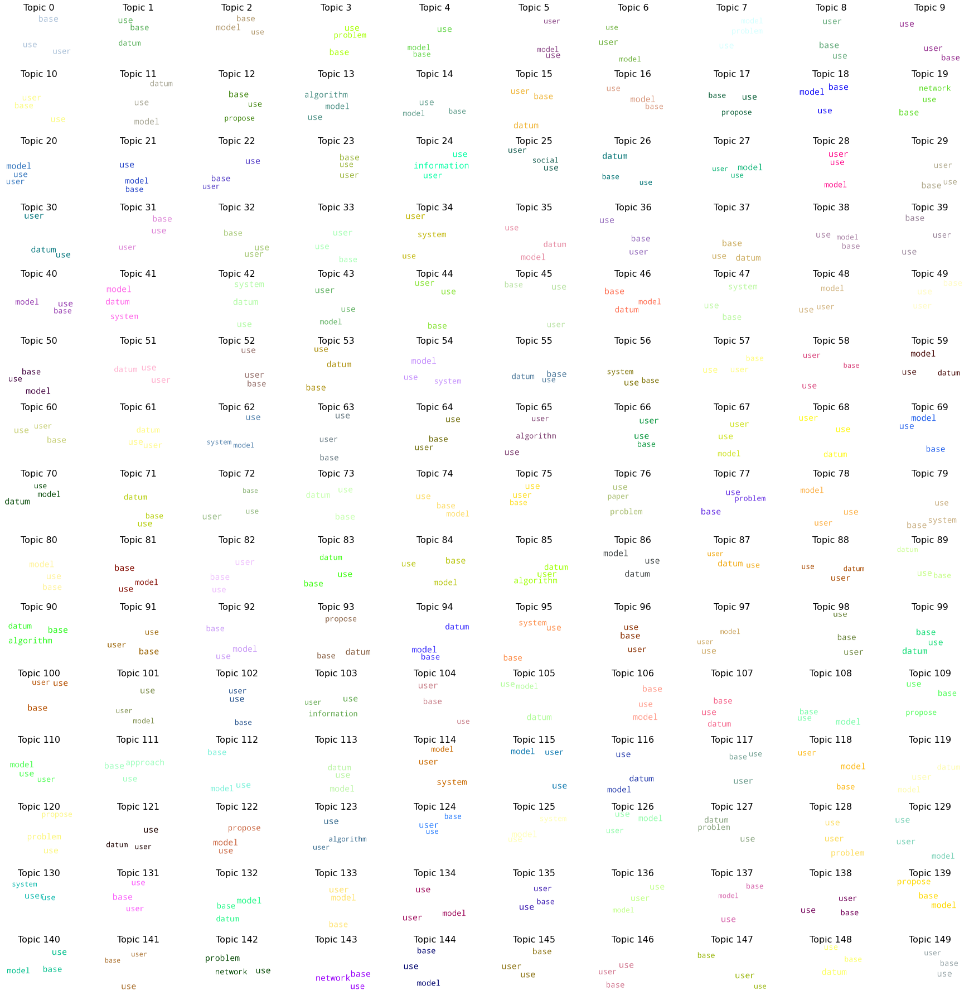

In [230]:
fig, axes = plt.subplots(15, 10, figsize=(25,25), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()